In [1]:
import numpy as np
import os
import datetime as datetime
import pandas as pd


os.system('source /home/jackalak/heartbeat/cdf38_0-dist/bin/definitions.B')
os.environ["CDF_LIB"] = '/home/jackalak/heartbeat/cdf38_0-dist/lib'
from spacepy import pycdf
from nasaomnireader import omnireader

import matplotlib.pyplot as plt


import numpy as np
import pandas as pd
from datetime import timedelta


import ftplib
import os


import numpy as np
import os
import datetime as datetime
import pandas as pd





import pickle
import glob



import tensorflow as tf
from tensorflow import keras
tf.keras.backend.set_floatx(
    'float32'
)

import datetime

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
import tensorflow

import numpy as np
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout
from sklearn import preprocessing


from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

import matplotlib.pyplot as plt
%matplotlib notebook

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.layers import Input

Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/nasaomnireader-0.1.0-py3.6.egg/nasaomnireader/__init__.py", line 5, in <module>
    from nasaomnireader.omnireader_config import config
ModuleNotFoundError: No module named 'nasaomnireader.omnireader_config'

Solar wind data files will be saved to /home/jackalak/.local/share/nasaomnireader


In [2]:

#https://github.com/tensorflow/tensorflow/issues/956
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.layers import InputSpec 
from tensorflow.python.keras.utils import conv_utils

class PeriodicPadding2D(layers.Layer):

  def __init__(self, padding=1, **kwargs):
    super(PeriodicPadding2D, self).__init__(**kwargs)
    self.padding = conv_utils.normalize_tuple(padding, 1, 'padding')
    self.input_spec = InputSpec(ndim=4)

  def wrap_pad(self, input, size):
    M1 = tf.concat([input[:,:, -size:], input, input[:,:, 0:size]], 2)
    M1 = tf.concat([M1[:,0:size, :], M1, M1[:,0:size, :]], 1) #not periodic
    return M1

  def compute_output_shape(self, input_shape):
    shape = list(input_shape)
    assert len(shape) == 3  
    if shape[1] is not None:
      length = shape[1] + 2*self.padding[0]
    else:
      length = None
    return tuple([shape[0], length, length])

  def call(self, inputs): 
    return self.wrap_pad(inputs, self.padding[0])

  def get_config(self):
    config = {'padding': self.padding}
    base_config = super(PeriodicPadding2D, self).get_config()
    return dict(list(base_config.items()) + list(config.items()))


In [3]:
def plot_model(df_results, test):
    
    subdir = 'figures2/energyflux/'

    y_val_log = np.log10(test['ELE_TOTAL_ENERGY_FLUX'])
    
    plt.figure()
    plt.title('Electron Total Energy Flux, log10 scale')    
    plt.plot(y_val_log[:],alpha=0.5)
    plt.plot(df_results[:],alpha=0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.ylabel('log10 eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'1',dpi=dpi)
    
    plt.figure()
    plt.title('Electron Total Energy Flux')   
    plt.plot(10**y_val_log[:]*1.6e-6,alpha=0.5)
    plt.plot(10**df_results[:]*1.6e-6,alpha=0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.ylabel('erg/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'2',dpi=dpi)
    start=int(y_val_log.shape[0]/2)
    plt.figure()
    plt.title('Electron Total Energy Flux, log10 scale')   
    plt.plot(y_val_log[start:2000+start],alpha=0.5)
    plt.plot(df_results[start:2000+start],alpha=0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.ylabel('log10 eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'3',dpi=dpi)
    plt.figure()
    plt.title('Electron Total Energy Flux')   
    plt.plot(10**y_val_log[start:2000+start]*1.6e-6,alpha=0.5)
    plt.plot(10**df_results[start:2000+start]*1.6e-6,alpha=0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.ylabel('erg/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'4',dpi=dpi)
    

    minr = np.min(y_val_log.values)
    maxr = np.max(y_val_log.values)
    plt.figure()
    plt.title('Histogram of Electron Total Energy Flux, log10 scale')   
    plt.hist(y_val_log.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.hist(df_results.values,bins=200,alpha=0.5,range=(minr,maxr))
    plt.legend(['val','result'], loc='upper left')
    plt.ylabel('#/bin')
    plt.xlabel('log10 eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'5',dpi=dpi)
    plt.figure()
    plt.title('Histogram of Electron Total Energy Flux')   
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True,range=(10**minr*1.6e-6,10**maxr*1.6e-6),alpha=0.5)
    plt.hist(10**df_results.values*1.6e-6,bins=100, log=True,range=(10**minr*1.6e-6,10**maxr*1.6e-6),alpha=0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.ylabel('#/bin')
    plt.xlabel('erg/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'6',dpi=dpi)
    import matplotlib.colors as mcolors
    gamma = 0.2#[0.8, 0.5, 0.3]

    errors= y_val_log.values-df_results.values[:,0]
    plt.figure();
    plt.hist2d(test['SC_AACGM_LAT'].values, errors,
                  bins=50, norm=mcolors.PowerNorm(gamma))
    plt.title('Error density over SC_AACGM_LAT Bins')
    plt.xlabel('SC_AACGM_LAT degrees')
    plt.ylabel('log10(y_true)-log10(y_pred) eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'7',dpi=dpi)
    plt.figure()
    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((test['SC_AACGM_LAT'].values[j]-45)/((90-45)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/bin_total
    plt.scatter(np.linspace(45,90,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.xlabel('SC_AACGM_LAT degrees')
    plt.ylabel('log10(y_true)-log10(y_pred) eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'8',dpi=dpi)
    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((y_val_log[j]-minr)/((maxr-minr)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/(bin_total+.00001)
    plt.figure()
    plt.scatter(np.linspace(minr,maxr,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over target Bins')    
    plt.xlabel('log10(y_true) eV/cm^2/ster/s')
    plt.ylabel('log10(y_true)-log10(y_pred) eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'9',dpi=dpi)
    import matplotlib.colors as mcolors
    gamma = 0.2#[0.8, 0.5, 0.3]
    errors= y_val_log.values-df_results.values[:,0]

    plt.figure();
    plt.hist2d(y_val_log.values, errors,
                  bins=50, norm=mcolors.PowerNorm(gamma))
    plt.colorbar()
    plt.title('Error Density')
    plt.xlabel('log10(y_true) eV/cm^2/ster/s')
    plt.ylabel('log10(y_true)-log10(y_pred) eV/cm^2/ster/s')
    plt.show()
    plt.savefig(subdir+'10',dpi=dpi)
    plt.figure();
    plt.hist2d(y_val_log.values, df_results.values[:,0],
                  bins=50, norm=mcolors.PowerNorm(gamma))
    plt.colorbar()
    plt.title('Error Density')
    plt.xlabel('log10(y_true) eV/cm^2/ster/s')
    plt.ylabel('log10(y_pred) eV/cm^2/ster/s')
    temp = np.array([7,8,9,10,11,12,13])
    plt.plot(temp,temp,color='k')
    plt.xlim([7,13])
    plt.ylim([7,13])
    plt.show()
    plt.savefig(subdir+'11',dpi=dpi)

In [4]:

# # LOAD THE COMBINED SOURTHERN HEMISPHERE AND NORTHERN HEMISPHERE AS CREATED ABOVE
# test = pd.DataFrame()

# for ii in [17,18,6,7,8,9,12,13,14,15,16,]:

#     filescname = "../Downloads/sc_df_cleaned_GFi_" + str(ii) + ".pkl"
#     pickle_file = open(filescname, "rb") 

#     test =pd.concat([test,pickle.load(pickle_file)] )
    
# # filescname = "./all_sc_df_1min_SH_NH_combined.pkl"
# # pickle_file = open(filescname, "rb") 
# # test =pickle.load(pickle_file)
# print(test.columns.tolist())

In [5]:

# LOAD THE COMBINED SOURTHERN HEMISPHERE AND NORTHERN HEMISPHERE AS CREATED ABOVE
df_cumulative = pd.DataFrame()
# for ii in [17,18,6,7,8,9,12,13,14,15,16,]:
#     filescname = "./sc_df_cleaned_GFi_" + str(ii) + ".pkl"
#     pickle_file = open(filescname, "rb") 
#     df_cumulative =pd.concat([df_cumulative,pickle.load(pickle_file)] )

filescname = "/media/jackalak/TOSHIBA EXT/heartbeat/ParticlePrecipitation/ML_DB_subsamp_ext_full_dfCumulative_complexHemisphereCombine.csv"
file= open(filescname, "rb") 
df_cumulative =pd.read_csv(file)
df_cumulative = df_cumulative.set_index('Datetimes')
df_cumulative.index = pd.to_datetime(df_cumulative.index)
print(df_cumulative.columns.tolist())

df_cumulative=df_cumulative[['SC_AACGM_LAT','SC_AACGM_LTIME', 'ELE_TOTAL_ENERGY_FLUX', 'ID_SC', 'sin_ut',
                             'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME',
                               'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr', 'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr', 'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr', 'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr', 'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'AE_45min', 'AL_45min', 'AU_45min', 'SymH_45min', 'PC_45min', 'vsw_45min', 'vx_45min', 'psw_45min', 'borovsky_45min', 'newell_45min', 'F107_30min', 'Bz_30min', 'By_30min', 'Bx_30min', 'AE_30min', 'AL_30min', 'AU_30min', 'SymH_30min', 'PC_30min', 'vsw_30min', 'vx_30min', 'psw_30min', 'borovsky_30min', 'newell_30min', 'F107_15min', 'Bz_15min', 'By_15min', 'Bx_15min', 'AE_15min', 'AL_15min', 'AU_15min', 'SymH_15min', 'PC_15min', 'vsw_15min', 'vx_15min', 'psw_15min', 'borovsky_15min', 'newell_15min', 'F107_10min', 'Bz_10min', 'By_10min', 'Bx_10min', 'AE_10min', 'AL_10min', 'AU_10min', 'SymH_10min', 'PC_10min', 'vsw_10min', 'vx_10min', 'psw_10min', 'borovsky_10min', 'newell_10min', 'F107_5min', 'Bz_5min', 'By_5min', 'Bx_5min', 'AE_5min', 'AL_5min', 'AU_5min', 'SymH_5min', 'PC_5min', 'vsw_5min', 'vx_5min', 'psw_5min', 'borovsky_5min', 'newell_5min'        ]]

df_cumulative.sort_index()
df_cumulative

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['ID_SC'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])

del df_cumulative

feature_cols = [ 'ID_SC', 'sin_ut','cos_ut', 'sin_doy', 'cos_doy', 
                     'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr', 'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr', 'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr', 'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr', 'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'AE_45min', 'AL_45min', 'AU_45min', 'SymH_45min', 'PC_45min', 'vsw_45min', 'vx_45min', 'psw_45min', 'borovsky_45min', 'newell_45min', 'F107_30min', 'Bz_30min', 'By_30min', 'Bx_30min', 'AE_30min', 'AL_30min', 'AU_30min', 'SymH_30min', 'PC_30min', 'vsw_30min', 'vx_30min', 'psw_30min', 'borovsky_30min', 'newell_30min', 'F107_15min', 'Bz_15min', 'By_15min', 'Bx_15min', 'AE_15min', 'AL_15min', 'AU_15min', 'SymH_15min', 'PC_15min', 'vsw_15min', 'vx_15min', 'psw_15min', 'borovsky_15min', 'newell_15min', 'F107_10min', 'Bz_10min', 'By_10min', 'Bx_10min', 'AE_10min', 'AL_10min', 'AU_10min', 'SymH_10min', 'PC_10min', 'vsw_10min', 'vx_10min', 'psw_10min', 'borovsky_10min', 'newell_10min', 'F107_5min', 'Bz_5min', 'By_5min', 'Bx_5min', 'AE_5min', 'AL_5min', 'AU_5min', 'SymH_5min', 'PC_5min', 'vsw_5min', 'vx_5min', 'psw_5min', 'borovsky_5min', 'newell_5min'               ]
print(len(feature_cols))

# Construct X and y
# feature_cols = [c for c in df_train.columns if not 'ELE' in c]
# print( (feature_cols))
#print(df_cumulative.columns)
X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))
XX = np.array(X_train_scaled, dtype=np.float32)
XX_test = np.array(X_val_scaled, dtype=np.float32)

del X_val, X_train

import tensorflow.keras.backend as K
from tensorflow.keras.layers import Input

['SC_AACGM_LAT', 'SC_AACGM_LTIME', 'ELE_TOTAL_ENERGY_FLUX', 'ELE_TOTAL_ENERGY_FLUX_STD', 'ELE_AVG_ENERGY', 'ELE_AVG_ENERGY_STD', 'ID_SC', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME', 'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr', 'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr', 'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr', 'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr', 'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'A

<IPython.core.display.Javascript object>


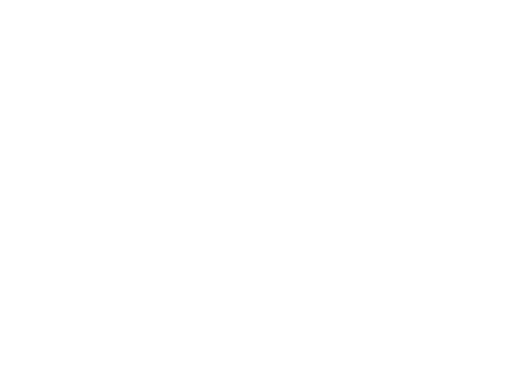

<IPython.core.display.Javascript object>


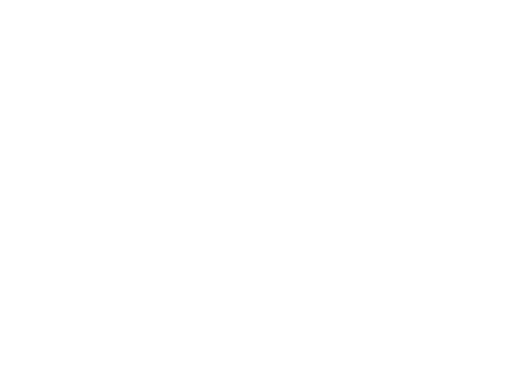

1838283


<IPython.core.display.Javascript object>


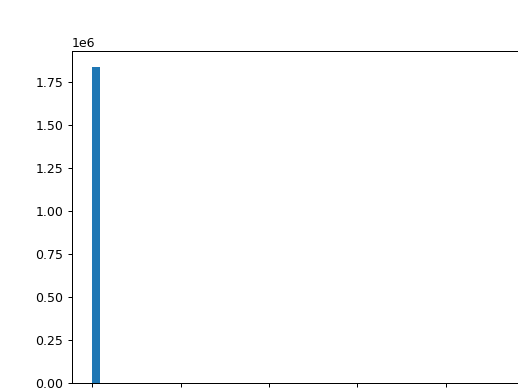

In [6]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),50)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+1))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==49:
        bin_i = 48
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1)
    
plt.figure()
plt.hist(sample_weights,bins=50)
plt.show()

In [7]:
import numpy as np

class DataGenerator_train(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_IDs, labels, batch_size=32, dim=(33), n_channels=1,
                 n_classes=10, shuffle=True, sample_weights=None):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.labels = labels
        self.list_IDs = list_IDs
        print(list_IDs)
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.on_epoch_end()
        self.sample_weights = sample_weights

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(list_IDs_temp)

        return X, y, self.sample_weights[list_IDs_temp]

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, list_IDs_temp):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = np.empty((self.batch_size, self.dim))
        y = np.zeros((self.batch_size,128,128))

        # Generate data
        for i, ID in enumerate(list_IDs_temp):
            # Store sample
            X[i,] =XX[ID,:] #np.load('data/' + ID + '.npy')
            for j in range(0,15): # will use moving window for 5 timesteps up to 3 SC_IDs
                if ((ID-7+j > 0) and (ID-7+j)<len(self.list_IDs)):
                    if(abs( (df_train.index[ID]-
                       df_train.index[ID-7+j] ).seconds) <=2*60 ):
                        
                        mlat = df_train['SC_AACGM_LAT'][ID-7+j]
                        mltime = df_train['SC_AACGM_LTIME'][ID-7+j]/24*2*np.pi 
                        mlat_j = int((90-mlat)/45*128)
                        mltime_k = int((mltime)/(2*np.pi)*128)

                        y[i,mlat_j,mltime_k] = y_train_log[ID-7+j]
                        

        return X, y
    

class DataGenerator_test(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_IDs, labels, batch_size=32, dim=(33), n_channels=1,
                 n_classes=10, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.labels = labels
        self.list_IDs = list_IDs
        print(list_IDs)
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(list_IDs_temp)

        return X, y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, list_IDs_temp):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = np.empty((self.batch_size, self.dim))
        y = np.zeros((self.batch_size,128,128))

        # Generate data
        for i, ID in enumerate(list_IDs_temp):
            # Store sample
            X[i,] =XX_test[ID,:] #np.load('data/' + ID + '.npy')
            mlat = df_val['SC_AACGM_LAT'][ID]
            mltime = df_val['SC_AACGM_LTIME'][ID]/24*2*np.pi 
            mlat_j = int((90-mlat)/45*128)
            mltime_k = int((mltime)/(2*np.pi)*128)
            #print( mlat,   mltime ,mlat_j,  mltime_k )


            y[i,mlat_j,mltime_k] = y_val_log[ID]

        return X, y
 

In [8]:
num_in = 145

# Parameters
params = {'dim': 145,
          'batch_size': 256,#2048,
          'n_classes': 6, # not used
          'n_channels': 1, # not used
          'shuffle': True,
         'sample_weights': sample_weights}

# Datasets
partition ={ 'train': np.linspace(0, df_train.shape[0]-1, df_train.shape[0]).astype(int), 'validation': np.linspace(0, df_val.shape[0]-1, df_val.shape[0]).astype(int)}
labels = { 'train': np.linspace(0, df_train.shape[0]-1, df_train.shape[0]).astype(int), 'validation': np.linspace(0, df_val.shape[0]-1, df_val.shape[0]).astype(int)}

# Generators
training_generator = DataGenerator_train(partition['train'], labels, **params)
params = {'dim': 145,
          'batch_size': 256,#2048,
          'n_classes': 6, # not used
          'n_channels': 1, # not used
          'shuffle': True}
validation_generator = DataGenerator_test(partition['validation'], labels, **params)

def custom_loss(y_true, y_pred):
    
    loss = K.sum(
        K.cast(K.greater(y_true, 0),'float32')*K.square(y_true-y_pred)*
        ( 1. +
         sample_weights[0]*K.cast(K.greater_equal(y_true,bins[0]),'float32')*K.cast(K.less_equal(y_true,bins[1]),'float32') +
sample_weights[1]*K.cast(K.greater_equal(y_true,bins[1]),'float32')*K.cast(K.less_equal(y_true,bins[2]),'float32') +
sample_weights[2]*K.cast(K.greater_equal(y_true,bins[2]),'float32')*K.cast(K.less_equal(y_true,bins[3]),'float32') +
sample_weights[3]*K.cast(K.greater_equal(y_true,bins[3]),'float32')*K.cast(K.less_equal(y_true,bins[4]),'float32') +
sample_weights[4]*K.cast(K.greater_equal(y_true,bins[4]),'float32')*K.cast(K.less_equal(y_true,bins[5]),'float32') +
sample_weights[5]*K.cast(K.greater_equal(y_true,bins[5]),'float32')*K.cast(K.less_equal(y_true,bins[6]),'float32') +
sample_weights[6]*K.cast(K.greater_equal(y_true,bins[6]),'float32')*K.cast(K.less_equal(y_true,bins[7]),'float32') +
sample_weights[7]*K.cast(K.greater_equal(y_true,bins[7]),'float32')*K.cast(K.less_equal(y_true,bins[8]),'float32') +
sample_weights[8]*K.cast(K.greater_equal(y_true,bins[8]),'float32')*K.cast(K.less_equal(y_true,bins[9]),'float32') +
sample_weights[9]*K.cast(K.greater_equal(y_true,bins[9]),'float32')*K.cast(K.less_equal(y_true,bins[10]),'float32') +
sample_weights[10]*K.cast(K.greater_equal(y_true,bins[10]),'float32')*K.cast(K.less_equal(y_true,bins[11]),'float32') +
sample_weights[11]*K.cast(K.greater_equal(y_true,bins[11]),'float32')*K.cast(K.less_equal(y_true,bins[12]),'float32') +
sample_weights[12]*K.cast(K.greater_equal(y_true,bins[12]),'float32')*K.cast(K.less_equal(y_true,bins[12+1]),'float32') +
sample_weights[13]*K.cast(K.greater_equal(y_true,bins[13]),'float32')*K.cast(K.less_equal(y_true,bins[13+1]),'float32') +
sample_weights[14]*K.cast(K.greater_equal(y_true,bins[14]),'float32')*K.cast(K.less_equal(y_true,bins[14+1]),'float32') +
sample_weights[15]*K.cast(K.greater_equal(y_true,bins[15]),'float32')*K.cast(K.less_equal(y_true,bins[15+1]),'float32') +
sample_weights[16]*K.cast(K.greater_equal(y_true,bins[16]),'float32')*K.cast(K.less_equal(y_true,bins[16+1]),'float32') +
sample_weights[17]*K.cast(K.greater_equal(y_true,bins[17]),'float32')*K.cast(K.less_equal(y_true,bins[17+1]),'float32') +
sample_weights[18]*K.cast(K.greater_equal(y_true,bins[18]),'float32')*K.cast(K.less_equal(y_true,bins[18+1]),'float32') +
sample_weights[19]*K.cast(K.greater_equal(y_true,bins[19]),'float32')*K.cast(K.less_equal(y_true,bins[19+1]),'float32') +
sample_weights[20]*K.cast(K.greater_equal(y_true,bins[20]),'float32')*K.cast(K.less_equal(y_true,bins[20+1]),'float32') +
sample_weights[21]*K.cast(K.greater_equal(y_true,bins[21]),'float32')*K.cast(K.less_equal(y_true,bins[21+1]),'float32') +
sample_weights[22]*K.cast(K.greater_equal(y_true,bins[22]),'float32')*K.cast(K.less_equal(y_true,bins[22+1]),'float32') +
sample_weights[23]*K.cast(K.greater_equal(y_true,bins[23]),'float32')*K.cast(K.less_equal(y_true,bins[23+1]),'float32') +
sample_weights[24]*K.cast(K.greater_equal(y_true,bins[24]),'float32')*K.cast(K.less_equal(y_true,bins[24+1]),'float32') +
sample_weights[25]*K.cast(K.greater_equal(y_true,bins[25]),'float32')*K.cast(K.less_equal(y_true,bins[25+1]),'float32') +
sample_weights[26]*K.cast(K.greater_equal(y_true,bins[26]),'float32')*K.cast(K.less_equal(y_true,bins[26+1]),'float32') +
sample_weights[27]*K.cast(K.greater_equal(y_true,bins[27]),'float32')*K.cast(K.less_equal(y_true,bins[27+1]),'float32') +
sample_weights[28]*K.cast(K.greater_equal(y_true,bins[28]),'float32')*K.cast(K.less_equal(y_true,bins[28+1]),'float32') +
sample_weights[29]*K.cast(K.greater_equal(y_true,bins[29]),'float32')*K.cast(K.less_equal(y_true,bins[29+1]),'float32') +
sample_weights[30]*K.cast(K.greater_equal(y_true,bins[30]),'float32')*K.cast(K.less_equal(y_true,bins[30+1]),'float32') +
sample_weights[31]*K.cast(K.greater_equal(y_true,bins[31]),'float32')*K.cast(K.less_equal(y_true,bins[31+1]),'float32') +
sample_weights[32]*K.cast(K.greater_equal(y_true,bins[32]),'float32')*K.cast(K.less_equal(y_true,bins[32+1]),'float32') +
sample_weights[33]*K.cast(K.greater_equal(y_true,bins[33]),'float32')*K.cast(K.less_equal(y_true,bins[33+1]),'float32') +
sample_weights[34]*K.cast(K.greater_equal(y_true,bins[34]),'float32')*K.cast(K.less_equal(y_true,bins[34+1]),'float32') +
sample_weights[35]*K.cast(K.greater_equal(y_true,bins[35]),'float32')*K.cast(K.less_equal(y_true,bins[35+1]),'float32') +
sample_weights[36]*K.cast(K.greater_equal(y_true,bins[36]),'float32')*K.cast(K.less_equal(y_true,bins[36+1]),'float32') +
sample_weights[37]*K.cast(K.greater_equal(y_true,bins[37]),'float32')*K.cast(K.less_equal(y_true,bins[37+1]),'float32') +
sample_weights[38]*K.cast(K.greater_equal(y_true,bins[38]),'float32')*K.cast(K.less_equal(y_true,bins[38+1]),'float32') +
sample_weights[39]*K.cast(K.greater_equal(y_true,bins[39]),'float32')*K.cast(K.less_equal(y_true,bins[39+1]),'float32') +
sample_weights[40]*K.cast(K.greater_equal(y_true,bins[40]),'float32')*K.cast(K.less_equal(y_true,bins[40+1]),'float32') +
sample_weights[41]*K.cast(K.greater_equal(y_true,bins[41]),'float32')*K.cast(K.less_equal(y_true,bins[41+1]),'float32') +
sample_weights[42]*K.cast(K.greater_equal(y_true,bins[42]),'float32')*K.cast(K.less_equal(y_true,bins[42+1]),'float32') +
sample_weights[43]*K.cast(K.greater_equal(y_true,bins[43]),'float32')*K.cast(K.less_equal(y_true,bins[43+1]),'float32') +
sample_weights[44]*K.cast(K.greater_equal(y_true,bins[44]),'float32')*K.cast(K.less_equal(y_true,bins[44+1]),'float32') +
sample_weights[45]*K.cast(K.greater_equal(y_true,bins[45]),'float32')*K.cast(K.less_equal(y_true,bins[45+1]),'float32') +
sample_weights[46]*K.cast(K.greater_equal(y_true,bins[46]),'float32')*K.cast(K.less_equal(y_true,bins[46+1]),'float32') +
sample_weights[47]*K.cast(K.greater_equal(y_true,bins[47]),'float32')*K.cast(K.less_equal(y_true,bins[47+1]),'float32') +
sample_weights[48]*K.cast(K.greater_equal(y_true,bins[48]),'float32')*K.cast(K.less_equal(y_true,bins[48+1]),'float32') 
#+sample_weights[49]*K.cast(K.greater_equal(y_true,bins[49]),'float32')*K.cast(K.less_equal(y_true,bins[49+1]),'float32') 
    ) )  / ( K.sum( K.cast(K.greater(y_true, 0),'float32') ))# finds the number of y_true  > 0
    
    return loss



def custom_mse(y_true, y_pred):
    

    
    mse = K.sum( K.cast(K.greater(y_true, 0),'float32')*(
        K.square(y_true-y_pred)) )/params['batch_size']  
    return mse



[      0       1       2 ... 1838280 1838281 1838282]
[    0     1     2 ... 55207 55208 55209]


In [9]:
input1 = Input(shape=(num_in))

model1 = Dense(256, activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(int(64),   activation='relu')(model1)
model1 = Dense(int(32),   activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = tf.keras.layers.Reshape((16, 16, 1))(model1)
# 16x16 to 16 32x32 feature map
model1 = tf.keras.layers.Conv2DTranspose(64, (9,9),
                strides=(2,2), padding='same')(model1)
model1 = tf.keras.layers.Conv2DTranspose(64, (5,5),
                strides=(4,4), padding='same')(model1)
# 4 128x128 feature map to 1 128x128
model1 = model1 = Dropout(0.2)(model1)
model1 = PeriodicPadding2D(4)(model1)
model1 = tf.keras.layers.Conv2D(1, kernel_size=(9,9),
                              padding='valid')(model1)
output = model1

model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer=tf.keras.optimizers.Adam(
    learning_rate=0.001),metrics=custom_mse)
model.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 145)]             0         
_________________________________________________________________
dense (Dense)                (None, 256)               37376     
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 64)                16448     
_________________________________________________________________
dense_2 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_3 (Dense)              (None, 256)               8448      
_________________________________________________________________
reshape (Reshape)            (None, 16, 16, 1)        

In [19]:
history = model.fit(training_generator, 
                    validation_data=validation_generator,
                    batch_size=params['batch_size'],epochs=300,#verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=60)], use_multiprocessing=True,
                     workers=6)#

Epoch 1/300
7180/7180 [==============================] - 3382s 471ms/step - loss: 3553.2158 - custom_mse: 9.4018 - val_loss: 32.7258 - val_custom_mse: 1.0900
Epoch 2/300
7180/7180 [==============================] - 3345s 466ms/step - loss: 1482.1688 - custom_mse: 2.9539 - val_loss: 33.8284 - val_custom_mse: 1.1004
Epoch 3/300
7180/7180 [==============================] - 3297s 459ms/step - loss: 1396.1938 - custom_mse: 2.6393 - val_loss: 42.1209 - val_custom_mse: 1.3781
Epoch 4/300
7180/7180 [==============================] - 3284s 457ms/step - loss: 1120.9004 - custom_mse: 2.1358 - val_loss: 30.5642 - val_custom_mse: 1.0019
Epoch 5/300
7180/7180 [==============================] - 3284s 457ms/step - loss: 1293.9866 - custom_mse: 2.1124 - val_loss: 33.6220 - val_custom_mse: 1.1016
Epoch 6/300
7180/7180 [==============================] - 3284s 457ms/step - loss: 1154.6700 - custom_mse: 1.7879 - val_loss: 32.4982 - val_custom_mse: 1.0417
Epoch 7/300
7180/7180 [=============================

7180/7180 [==============================] - 3284s 457ms/step - loss: 1007.4631 - custom_mse: 1.8257 - val_loss: 30.2529 - val_custom_mse: 0.9904
Epoch 9/300
7180/7180 [==============================] - 3280s 457ms/step - loss: 1034.6641 - custom_mse: 1.8363 - val_loss: 31.4014 - val_custom_mse: 1.0077
Epoch 10/300
7180/7180 [==============================] - 3280s 457ms/step - loss: 949.2548 - custom_mse: 1.7446 - val_loss: 29.8721 - val_custom_mse: 0.9805
Epoch 11/300
7180/7180 [==============================] - 3279s 457ms/step - loss: 884.6926 - custom_mse: 1.6456 - val_loss: 29.4006 - val_custom_mse: 0.9803
Epoch 12/300
7180/7180 [==============================] - 3280s 457ms/step - loss: 911.5518 - custom_mse: 1.6867 - val_loss: 31.2186 - val_custom_mse: 1.0180
Epoch 13/300
7180/7180 [==============================] - 3279s 457ms/step - loss: 1118.6661 - custom_mse: 1.8625 - val_loss: 30.8177 - val_custom_mse: 1.0026
Epoch 14/300
7180/7180 [==============================] - 3278s

7180/7180 [==============================] - 3280s 457ms/step - loss: 882.4077 - custom_mse: 1.6305 - val_loss: 28.3466 - val_custom_mse: 0.9300
Epoch 17/300
7180/7180 [==============================] - 3282s 457ms/step - loss: 906.7671 - custom_mse: 1.6526 - val_loss: 30.4572 - val_custom_mse: 0.9866
Epoch 18/300
7180/7180 [==============================] - 3282s 457ms/step - loss: 885.7784 - custom_mse: 1.6209 - val_loss: 29.4645 - val_custom_mse: 0.9601
Epoch 19/300
7180/7180 [==============================] - 3283s 457ms/step - loss: 966.6920 - custom_mse: 1.6939 - val_loss: 31.1727 - val_custom_mse: 0.9990
Epoch 20/300
7180/7180 [==============================] - 3283s 457ms/step - loss: 1003.6987 - custom_mse: 1.7593 - val_loss: 30.2280 - val_custom_mse: 0.9849
Epoch 21/300
7180/7180 [==============================] - 3282s 457ms/step - loss: 926.3929 - custom_mse: 1.6868 - val_loss: 27.5438 - val_custom_mse: 0.9035
Epoch 22/300
7180/7180 [==============================] - 3300s 

Process Keras_worker_ForkPoolWorker-576:
Process Keras_worker_ForkPoolWorker-571:
Process Keras_worker_ForkPoolWorker-574:
Process Keras_worker_ForkPoolWorker-575:
Process Keras_worker_ForkPoolWorker-572:
Process Keras_worker_ForkPoolWorker-573:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 93, in r

KeyboardInterrupt: 

Process Keras_worker_ForkPoolWorker-579:
Process Keras_worker_ForkPoolWorker-586:
Process Keras_worker_ForkPoolWorker-587:
Process Keras_worker_ForkPoolWorker-583:
Process Keras_worker_ForkPoolWorker-585:
Process Keras_worker_ForkPoolWorker-588:
Process Keras_worker_ForkPoolWorker-577:
Process Keras_worker_ForkPoolWorker-584:
Process Keras_worker_ForkPoolWorker-580:
Process Keras_worker_ForkPoolWorker-578:
Process Keras_worker_ForkPoolWorker-582:
Process Keras_worker_ForkPoolWorker-581:
Traceback (most recent call last):
Traceback (most recent call last):
Process Keras_worker_ForkPoolWorker-589:
Process Keras_worker_ForkPoolWorker-590:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Process Keras_worker_ForkPoolWorker-591:
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap


In [10]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
#model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})

In [11]:
history = model.fit(training_generator, 
                    validation_data=validation_generator,
                    batch_size=params['batch_size'],epochs=32,#verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=60)], use_multiprocessing=True,
                     workers=6)#

Epoch 1/32
7180/7180 [==============================] - 3371s 469ms/step - loss: 856.5964 - custom_mse: 1.5745 - val_loss: 29.6032 - val_custom_mse: 0.9610
Epoch 2/32
7180/7180 [==============================] - 3292s 459ms/step - loss: 986.2334 - custom_mse: 1.7575 - val_loss: 29.1177 - val_custom_mse: 0.9582
Epoch 3/32
7180/7180 [==============================] - 3288s 458ms/step - loss: 1092.9774 - custom_mse: 1.8114 - val_loss: 28.7603 - val_custom_mse: 0.9543
Epoch 4/32
7180/7180 [==============================] - 3289s 458ms/step - loss: 979.2667 - custom_mse: 1.8277 - val_loss: 26.9686 - val_custom_mse: 0.8909
Epoch 5/32
7180/7180 [==============================] - 3288s 458ms/step - loss: 892.2574 - custom_mse: 1.6665 - val_loss: 29.0829 - val_custom_mse: 0.9463
Epoch 6/32
7180/7180 [==============================] - 3288s 458ms/step - loss: 889.9309 - custom_mse: 1.6107 - val_loss: 26.7142 - val_custom_mse: 0.8907
Epoch 7/32
7180/7180 [==============================] - 3289s 4

7180/7180 [==============================] - 3287s 458ms/step - loss: 1151.8289 - custom_mse: 1.8808 - val_loss: 33.5456 - val_custom_mse: 1.0581
Epoch 9/32
7180/7180 [==============================] - 3288s 458ms/step - loss: 913.5103 - custom_mse: 1.6925 - val_loss: 29.8328 - val_custom_mse: 0.9648
Epoch 10/32
7180/7180 [==============================] - 3287s 458ms/step - loss: 959.6422 - custom_mse: 1.7540 - val_loss: 29.4394 - val_custom_mse: 0.9558
Epoch 11/32
7180/7180 [==============================] - 3288s 458ms/step - loss: 888.7995 - custom_mse: 1.6607 - val_loss: 28.1316 - val_custom_mse: 0.9159
Epoch 12/32
7180/7180 [==============================] - 3288s 458ms/step - loss: 854.9129 - custom_mse: 1.5751 - val_loss: 26.3809 - val_custom_mse: 0.8951
Epoch 13/32
7180/7180 [==============================] - 3287s 458ms/step - loss: 912.4409 - custom_mse: 1.6946 - val_loss: 28.0201 - val_custom_mse: 0.9128
Epoch 14/32
7180/7180 [==============================] - 3286s 458ms/s

7180/7180 [==============================] - 3285s 458ms/step - loss: 974.4610 - custom_mse: 1.7205 - val_loss: 28.7238 - val_custom_mse: 0.9201
Epoch 18/32
7180/7180 [==============================] - 3286s 458ms/step - loss: 1060.5564 - custom_mse: 1.8639 - val_loss: 29.9106 - val_custom_mse: 0.9786
Epoch 19/32
7180/7180 [==============================] - 3291s 458ms/step - loss: 1086.4692 - custom_mse: 1.8486 - val_loss: 28.4858 - val_custom_mse: 0.9884
Epoch 20/32
7180/7180 [==============================] - 3296s 459ms/step - loss: 878.4188 - custom_mse: 1.6177 - val_loss: 24.9909 - val_custom_mse: 0.8114
Epoch 21/32
7180/7180 [==============================] - 3361s 468ms/step - loss: 897.9868 - custom_mse: 1.7003 - val_loss: 25.7884 - val_custom_mse: 0.8409
Epoch 22/32
7180/7180 [==============================] - 3404s 474ms/step - loss: 828.5217 - custom_mse: 1.5290 - val_loss: 24.7852 - val_custom_mse: 0.8039
Epoch 23/32
7180/7180 [==============================] - 3462s 482ms

7180/7180 [==============================] - 3408s 475ms/step - loss: 872.3271 - custom_mse: 1.6376 - val_loss: 24.4684 - val_custom_mse: 0.8228
Epoch 26/32
1360/7180 [====>.........................] - ETA: 46:21 - loss: 950.3686 - custom_mse: 1.6624

Process Keras_worker_ForkPoolWorker-603:
Process Keras_worker_ForkPoolWorker-602:
Process Keras_worker_ForkPoolWorker-606:
Process Keras_worker_ForkPoolWorker-604:
Process Keras_worker_ForkPoolWorker-601:
Process Keras_worker_ForkPoolWorker-605:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 93, in r

KeyboardInterrupt: 

Process Keras_worker_ForkPoolWorker-608:
Process Keras_worker_ForkPoolWorker-612:
Process Keras_worker_ForkPoolWorker-610:
Process Keras_worker_ForkPoolWorker-611:
Process Keras_worker_ForkPoolWorker-607:
Process Keras_worker_ForkPoolWorker-609:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.6/multiprocessing/pro

In [10]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
# model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})


history = model.fit(training_generator, 
                    validation_data=validation_generator,
                    batch_size=params['batch_size'],epochs=15,#verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=60)], use_multiprocessing=True,
                     workers=6)#


Epoch 1/15
7180/7180 [==============================] - 3303s 460ms/step - loss: 880.3174 - custom_mse: 1.6392 - val_loss: 26.5516 - val_custom_mse: 0.8605
Epoch 2/15
7180/7180 [==============================] - 3293s 459ms/step - loss: 879.5652 - custom_mse: 1.6308 - val_loss: 26.0732 - val_custom_mse: 0.8408
Epoch 3/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 905.1834 - custom_mse: 1.6621 - val_loss: 24.9547 - val_custom_mse: 0.8241
Epoch 4/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 878.1810 - custom_mse: 1.6410 - val_loss: 25.3895 - val_custom_mse: 0.8283
Epoch 5/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 848.0208 - custom_mse: 1.5746 - val_loss: 23.7405 - val_custom_mse: 0.7637
Epoch 6/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 875.3995 - custom_mse: 1.6253 - val_loss: 24.0552 - val_custom_mse: 0.7797
Epoch 7/15
7180/7180 [==============================] - 3294s 45

7180/7180 [==============================] - 3295s 459ms/step - loss: 932.4554 - custom_mse: 1.6797 - val_loss: 32.9876 - val_custom_mse: 1.0685
Epoch 9/15
7180/7180 [==============================] - 3293s 459ms/step - loss: 880.4214 - custom_mse: 1.6198 - val_loss: 26.6433 - val_custom_mse: 0.8654
Epoch 10/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 864.9446 - custom_mse: 1.6139 - val_loss: 24.5397 - val_custom_mse: 0.7931
Epoch 11/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 865.3651 - custom_mse: 1.5908 - val_loss: 24.4776 - val_custom_mse: 0.8098
Epoch 12/15
7180/7180 [==============================] - 3295s 459ms/step - loss: 963.2964 - custom_mse: 1.7024 - val_loss: 26.5701 - val_custom_mse: 0.8674
Epoch 13/15
7180/7180 [==============================] - 3294s 459ms/step - loss: 840.1120 - custom_mse: 1.5502 - val_loss: 24.4272 - val_custom_mse: 0.8103
Epoch 14/15
7180/7180 [==============================] - 3294s 459ms/st

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f/assets


<IPython.core.display.Javascript object>


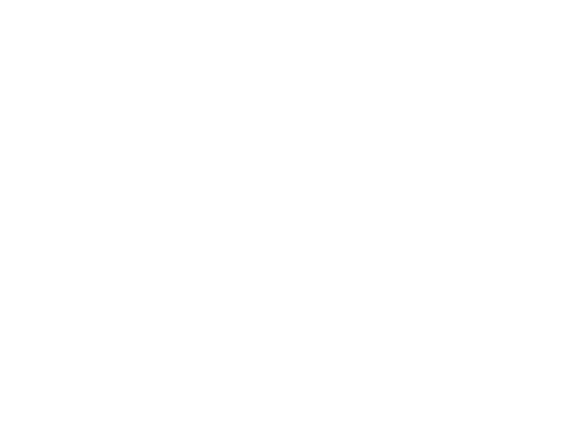

<IPython.core.display.Javascript object>


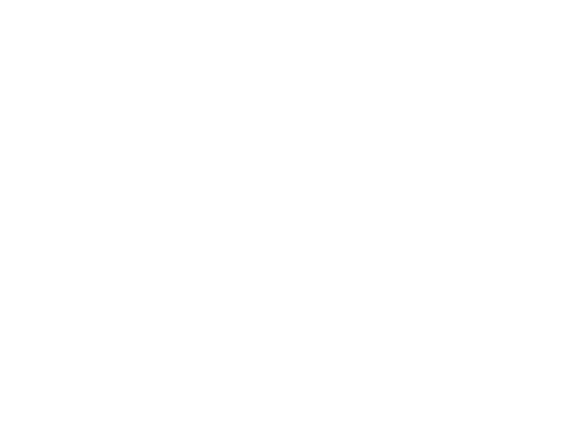

In [11]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()



INFO:tensorflow:Assets written to: mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f/assets


<IPython.core.display.Javascript object>


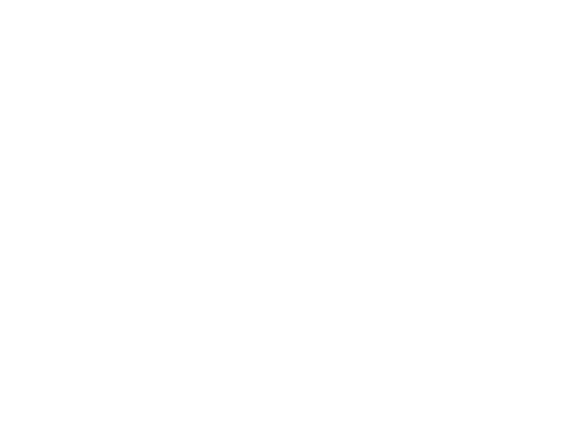

<IPython.core.display.Javascript object>


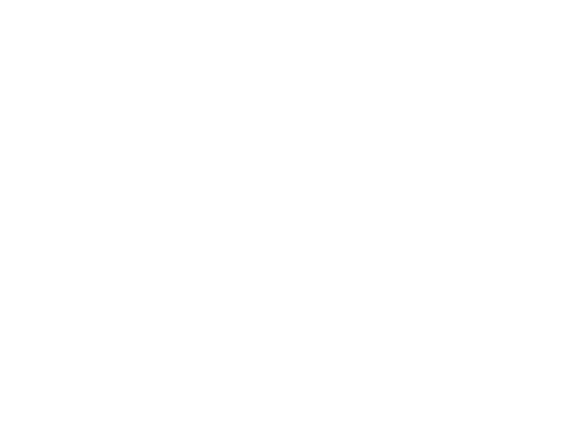

In [12]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()



In [15]:
def plot_hemisphere_CSV_val(scaler_X, model, features, test, XX_test):

    mark= ['s', 'o', 'D', 'v']

    y_val_log = np.log10(test['ELE_TOTAL_ENERGY_FLUX']+.0001)

    num = test.shape[0]
    
    %matplotlib inline
    plt.ioff()
    ovation_val = []
    result_val = []
    
    range1=np.max(np.max([-test['AL'].values,test['AE'].values,test['AU'].values]))
    
    ml_hemi = []
    ovation_hemi = []
    
    for i in range(0,num):


       #################################
        #
        #ML model
        ##########################
        results = model.predict( XX_test[i:i+1,:])
        mlatgridN = np.linspace(90,45,num=128)
        mltgridN =  np.linspace(0,24,num=128)   
        flux = 10**(results[0,:,:,0])*1.60218e-12*3.14159




        ###########################3
        # Ovation
        ########################
        dt = test.index[i]
        auroral_types = ['diff','mono','wave','ions']
        for jj in range(0,3):
            atype = auroral_types[jj]
            jtype ="energy"
            bincorrect = True
            combine_hemispheres = True
            dtstr = dt.strftime('%Y%m%d %H:%M')
            if jtype=='average energy':
                estimator = AverageEnergyEstimator(atype)
                get_precip_for_time = estimator.get_eavg_for_time
            else:
                estimator = FluxEstimator(atype,jtype)
                get_precip_for_time = estimator.get_flux_for_time


            tflux_kwargs = {'combine_hemispheres':combine_hemispheres,
                            'return_dF':True}
            fluxtupleN = get_precip_for_time(dt,hemi='N',**tflux_kwargs)
            mlatgridN,mltgridN,fluxgridN,newell_coupling = fluxtupleN
            fluxtupleS = get_precip_for_time(dt,hemi='S',**tflux_kwargs)
            mlatgridS,mltgridS,fluxgridS,newell_coupling = fluxtupleS

            if bincorrect:
                bcN = BinCorrector(mlatgridN,mltgridN)
                fluxgridN = bcN.fix(fluxgridN)
                bcS = BinCorrector(mlatgridS,mltgridS)
                fluxgridS = bcS.fix(fluxgridS)
                print("Correction Applied")

            if jj== 0:
                fluxgridN_sum = fluxgridN
                fluxgridS_sum = fluxgridS
            else:
                fluxgridN_sum = fluxgridN_sum+fluxgridN
                fluxgridS_sum = fluxgridN_sum+fluxgridS

           
       
        pt = i

        result_val.append( 
            flux[int((90-test['SC_AACGM_LAT'][pt])/45*128),int((test['SC_AACGM_LTIME'][pt])/24*128)] )
        if  test['SC_AACGM_LAT'][pt] <= 50:
            ovation_val.append( fluxgridN_sum[0,int((test['SC_AACGM_LTIME'][pt])/24*96)] )
        else:
            ovation_val.append( 
                fluxgridN_sum[int((90-test['SC_AACGM_LAT'][pt])/40*80),int((test['SC_AACGM_LTIME'][pt])/24*96)] )

       
        ml_hemi.append(flux)
        ovation_hemi.append(fluxgridN_sum)
    
        
    plt.show()
    
    for i in range(0,num):
        
        flux = ml_hemi[i]
        fluxgridN_sum =ovation_hemi[i]

        fig= plt.figure(figsize=(20,12))
        ax3 = plt.subplot2grid((4,4), (0,0), colspan=4,rowspan=1)
        ax1 = plt.subplot2grid((4,4), (1,0), colspan=4,rowspan=1)
        ax4 = plt.subplot2grid((4,4), (2,0), rowspan=2,colspan=2,polar=True)
        ax5 = plt.subplot2grid((4,4), (2, 2), rowspan=2,colspan=2,polar=True)
        
        ax1.plot(-test['AL'], marker=mark[1],markersize=3)
        ax1.plot(test['AE'], marker=mark[2],markersize=3)
        ax1.plot(test['AU'], marker=mark[3],markersize=3)
        ax1.plot([test.index[i],test.index[i]],[0,10000],'--')

        ax1.legend(['-AL','AE','AU'])
        ax1.set_ylim(top=range1)
        ax1.set_xlim(right=test.index[-1])
        ax1.set_xlabel('time (month, day, year labels)')
        ax1.set_title('Example Magnetic Indices',fontweight="bold")

       #################################
        #
        #ML model
        ##########################
        mlatgridN = np.linspace(90,45,num=128)
        mltgridN =  np.linspace(0,24,num=128)  



        pcolor_kwargs = {'cmap':'gnuplot','vmin':(10**0)*1.60218e-12,'vmax':(10**12.5)*1.60218e-12*3.14159}
        mappableN = pcolor_flux(ax5,mlatgridN,mltgridN,flux,'N',**pcolor_kwargs)

        ax5.set_title('Predicted Electron Precipitation Energy Flux (Neural Net)',fontweight="bold", fontsize='medium',pad=10)
        ax5.set_theta_zero_location('S')
        theta_label_values = np.array([0.,3.,6.,9.,12.,15.,18.,21.])*180./12
        theta_labels = ['%d:00' % (int(th/180.*12)) for th in theta_label_values.flatten().tolist()]
        ax5.set_thetagrids(theta_label_values,labels=theta_labels)

        r_label_values = 90.-np.array([80.,70.,60.,50.])
        r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
        ax5.set_rgrids(r_label_values,labels=r_labels)
        ax5.set_rlim([0.,45.])


        ###########################3
        # Ovation
        ########################
        dt = test.index[i]
        dtstr = dt.strftime('%Y%m%d %H:%M')
        mlatgridN = np.linspace(90,50,num=80)
        mltgridN = np.linspace(90,45,num=96)

        mappableN = pcolor_flux(ax4,mlatgridN,mltgridN,fluxgridN_sum,'N',**pcolor_kwargs)

        ax4.set_title('Predicted Electron Precipitation Energy Flux (OVATION Pyme)',pad =10,fontweight="bold", fontsize='medium')
        ax4.set_theta_zero_location('S')
        theta_label_values = np.array([0.,3.,6.,9.,12.,15.,18.,21.])*180./12
        theta_labels = ['%d:00' % (int(th/180.*12)) for th in theta_label_values.flatten().tolist()]
        ax4.set_thetagrids(theta_label_values,labels=theta_labels,fontsize='medium', )

        r_label_values = 90.-np.array([80.,70.,60.,50.])
        r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
        ax4.set_rgrids(r_label_values,labels=r_labels)
        ax4.set_rlim([0.,45.])
        plt.colorbar(mappableN,ax=ax5,label='Total Flux [erg/cm^2/s]',fraction=0.05,pad=0.09)
        plt.colorbar(mappableN,ax=ax4,label='Total Flux [erg/cm^2/s]',fraction=0.05,pad=0.09)

           
        ax4.scatter(test['SC_AACGM_LTIME'][i]/24*2*3.14159,90-test['SC_AACGM_LAT'][i])     
        ax5.scatter(test['SC_AACGM_LTIME'][i]/24*2*3.14159,90-test['SC_AACGM_LAT'][i])     
        ax4.tick_params(axis='y', colors='white')
        ax5.tick_params(axis='y', colors='white')


        ax3.set_title('Log Scale Electron Precipitation Energy Flux [Log10 eV/cm^2/s]'+' '+str(dt),fontweight="bold")
        ax3.set_title('Log Scale Electron Precipitation Energy Flux Log10 [eV/cm^2/s]'+' '+str(dt),fontweight="bold")
        ax3.plot(test.index,np.log10(np.array(ovation_val)/1.60218e-12), marker=mark[1])
        ax3.plot(test.index,np.log10(np.array(result_val)/1.60218e-12), marker=mark[2])
        ax3.plot(test.index,np.log10(10**(y_val_log)*3.14159), marker=mark[3])
        ax3.plot([test.index[i],test.index[i]],[7.5,13.5],'--')
        ax3.legend(['OVATION Pyme model','neural net: 0.5 deg / Mlat','measured value','current time'])
        ax3.set_ylim(top=13.5,bottom=7.5)
        ax3.set_xlim(right=test.index[-1])

        fig.tight_layout() 
        name = 'figures/movie_val_'+str(i) + '.png'
        fig.savefig(name,dpi=400)
        
    plt.show()
    
    #os.system('ffmpeg -r:v 5 -i "figures/movie_val_%01d.png" -codec:v libx264 -preset veryslow  "movie_val_2013_SC17.mp4";ffmpeg -i movie_val_2013_SC17.mp4 -c:v libx264 -c:a libmp3lame -b:a 384K movie_val_2013_SC17.avi;')
    return result_val, ovation_val


Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction Applied
Correction A

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y,

/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two min

/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two min

/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two min

/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two min

/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two min

/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10
/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two min

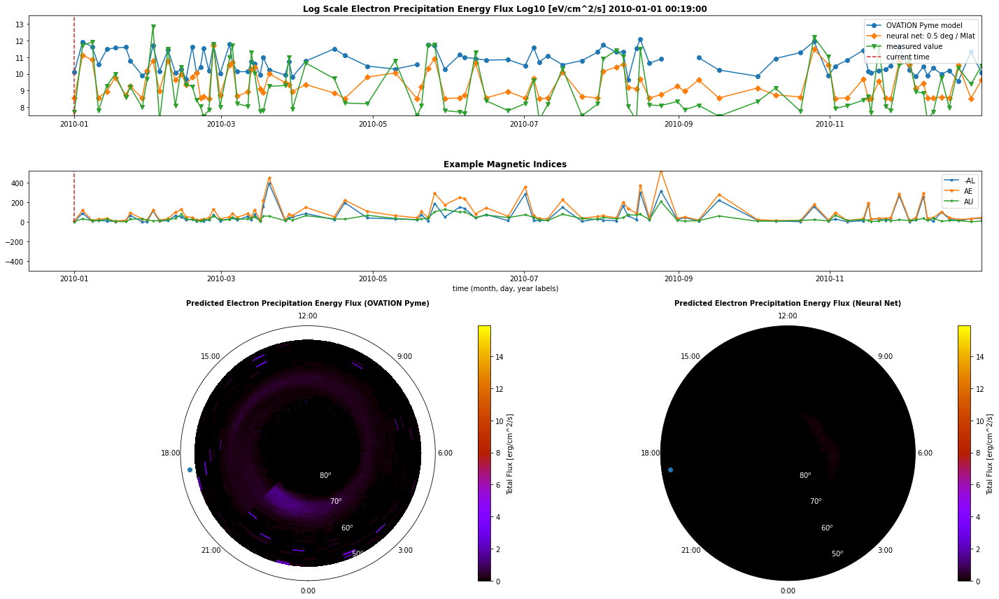

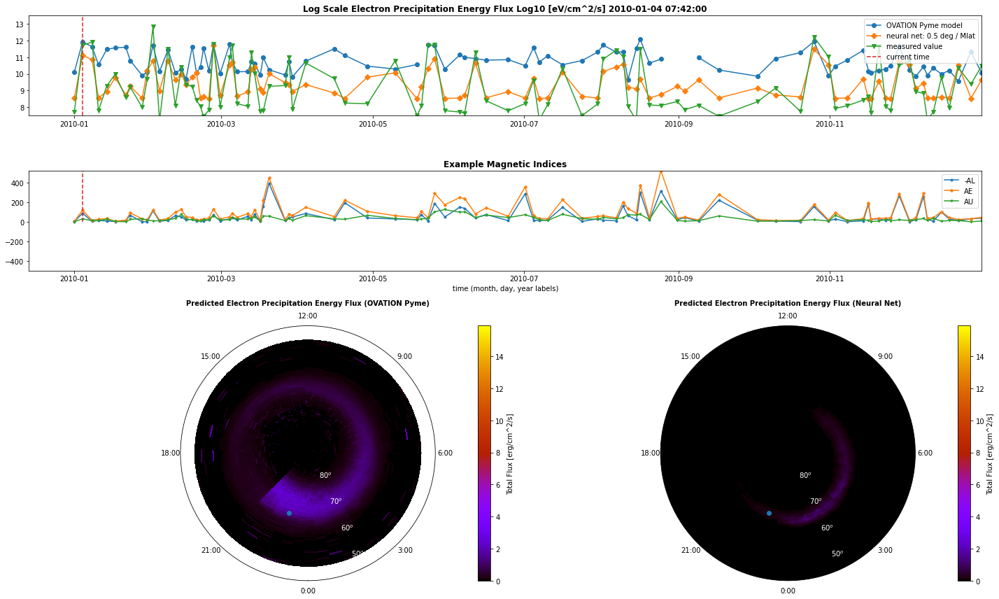

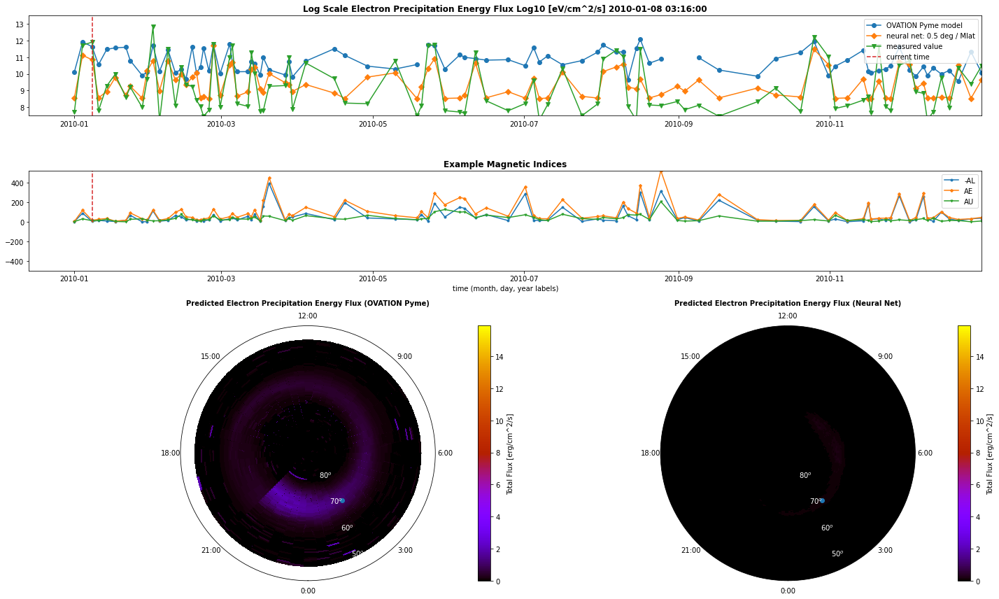

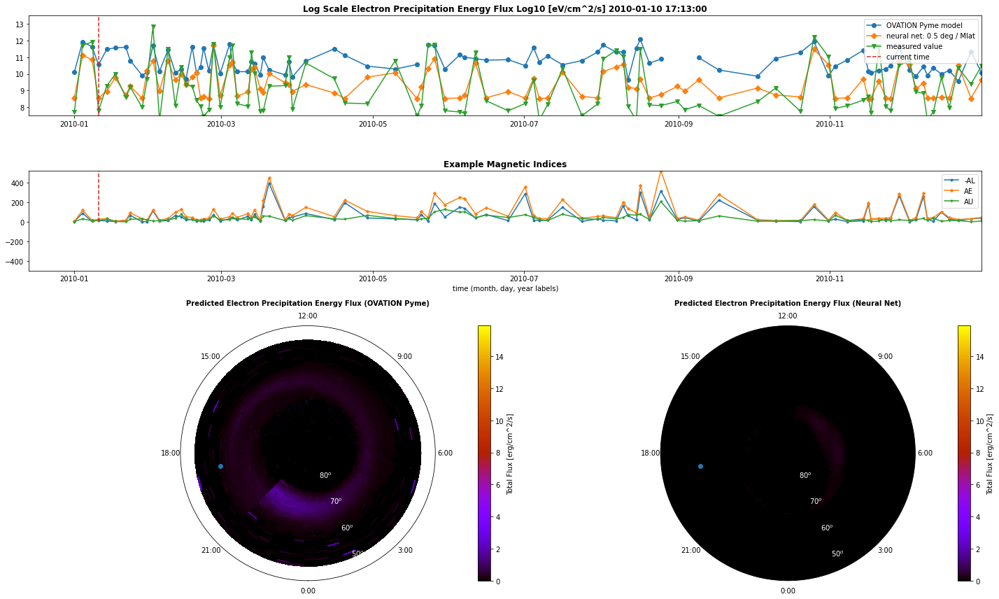

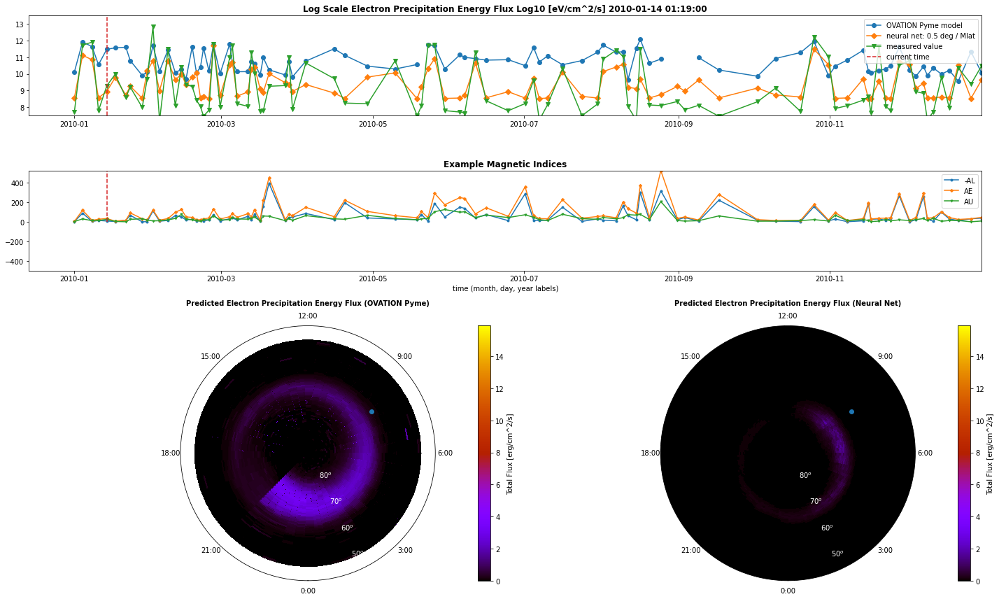

...

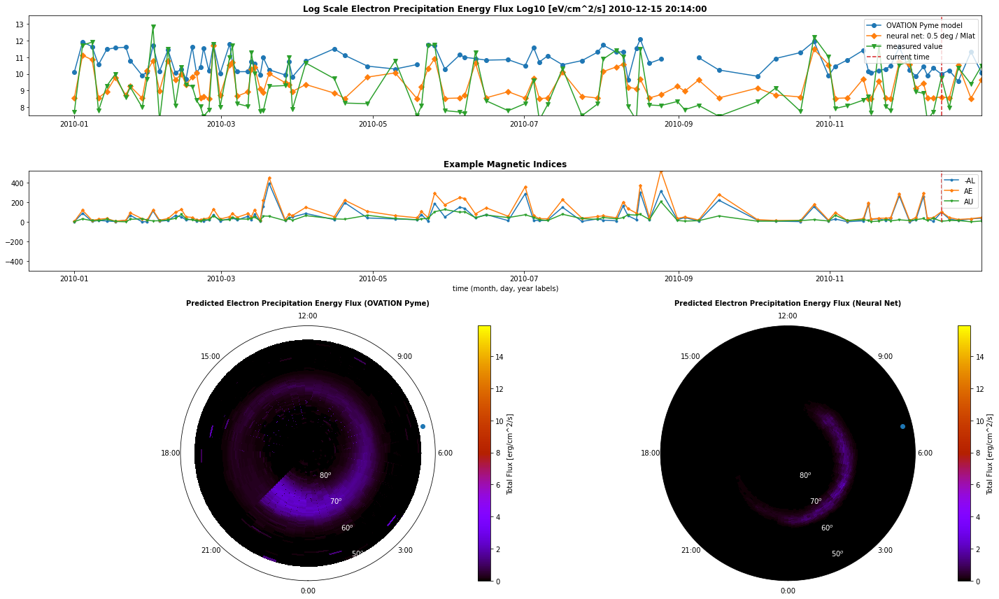

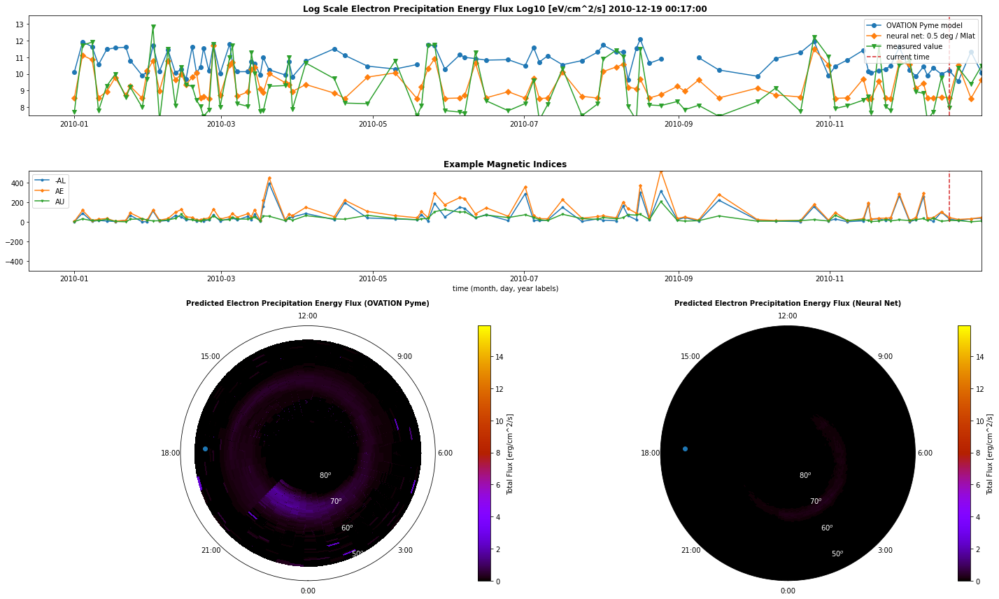

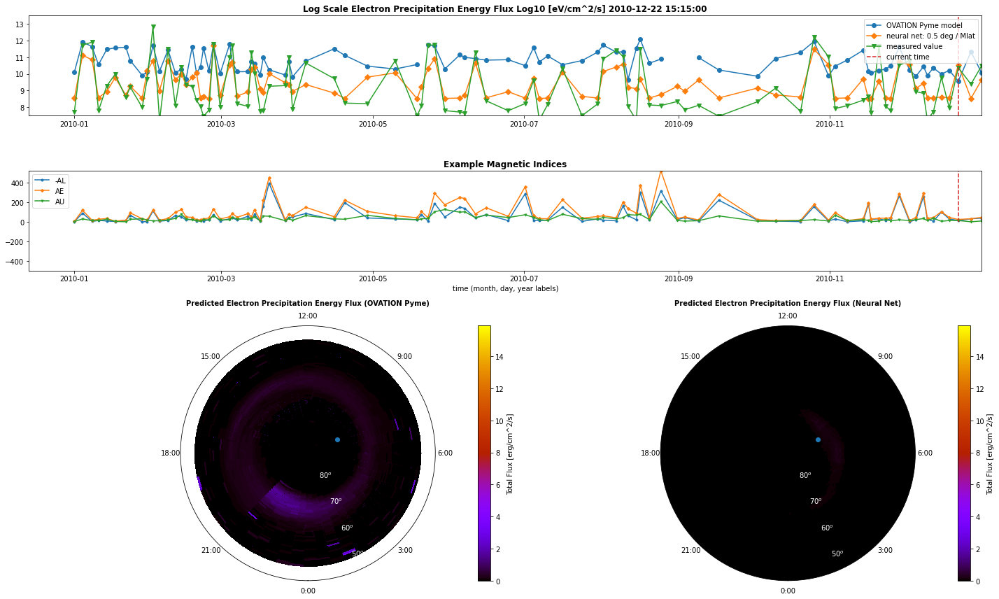

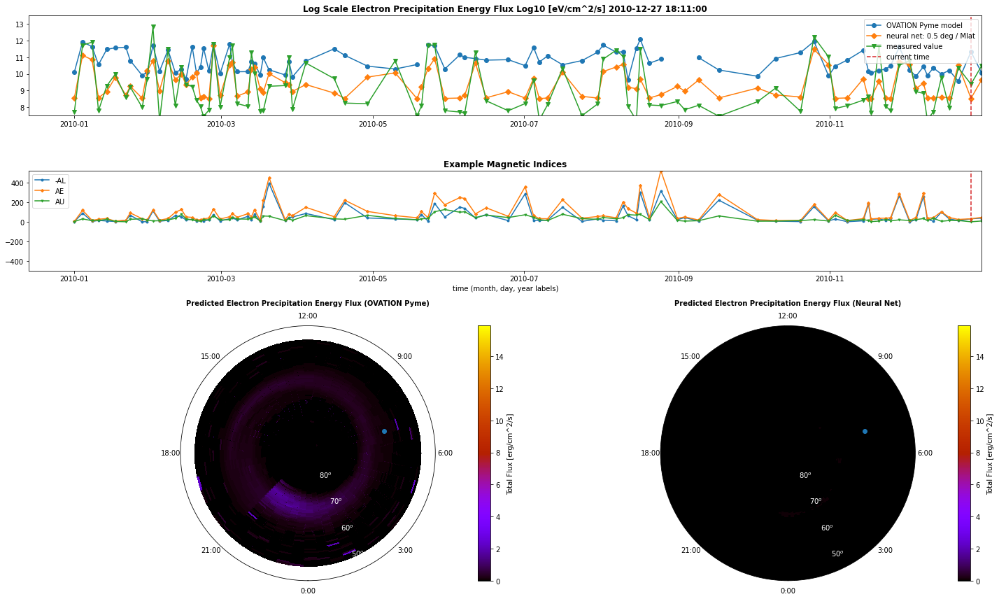

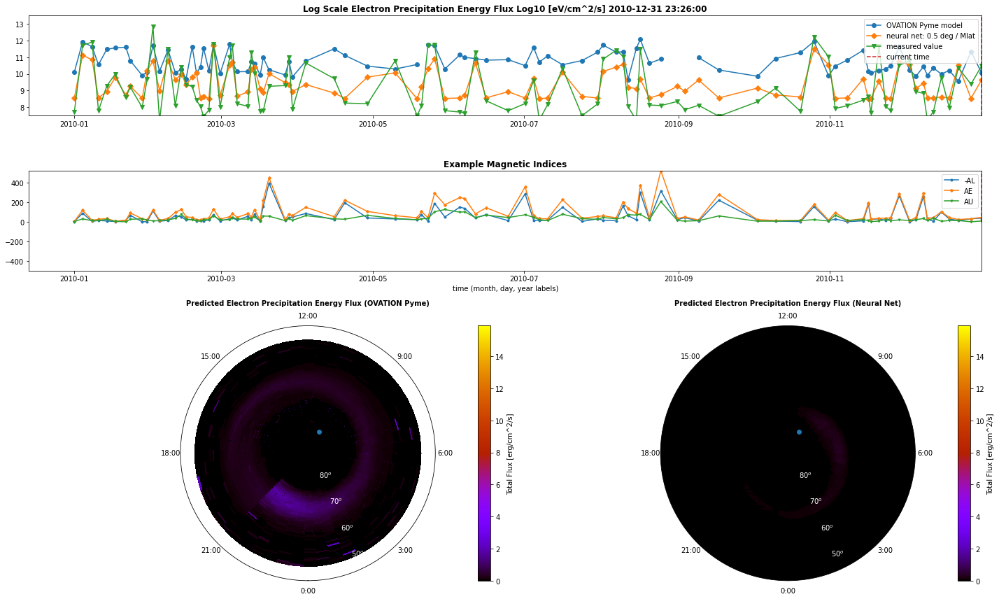

In [16]:
features = ['SC_AACGM_LAT', 'ELE_TOTAL_ENERGY_FLUX', 'ID_SC', 'sin_ut',
                             'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME',
                             'F107', 'AE', 'AL', 'AU', 'SymH', 
                             'F107_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'F107_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 
                             'F107_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 
                             'F107_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 
                             ]

result_val, ovation_val = plot_hemisphere_CSV_val(scaler_X, model, features, df_val[0:df_val.shape[0]:600], XX_test[0:df_val.shape[0]:600,:])


In [17]:
np.average( (y_val_log[0:df_val.shape[0]:600]-np.log10(np.array(result_val)/1.60218e-12/3.14159))**2)


0.8755837480222946

In [18]:
def for_CSV_val(scaler_X, model, features, test, XX_test):

    mark= ['s', 'o', 'D', 'v']

    y_val_log = np.log10(test['ELE_TOTAL_ENERGY_FLUX']+.0001)

    num = test.shape[0]
    
    %matplotlib inline
    plt.ioff()
    result_val = []

    
    for i in range(0,num):


       #################################
        #
        #ML model
        ##########################
        results = model.predict( XX_test[i:i+1,:])
        mlatgridN = np.linspace(90,45,num=128)
        mltgridN =  np.linspace(0,24,num=128)   
        flux = results[0,:,:,0]




           
       
        pt = i

        result_val.append( 
            flux[int((90-test['SC_AACGM_LAT'][pt])/45*128),int((test['SC_AACGM_LTIME'][pt])/24*128)] )

       
    
        

    return result_val

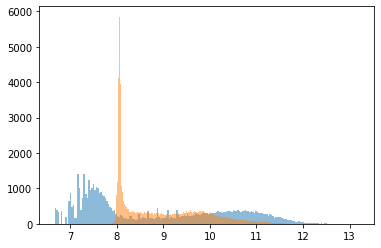

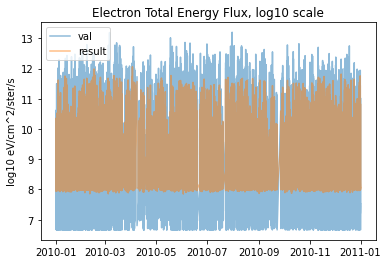

<Figure size 432x288 with 0 Axes>

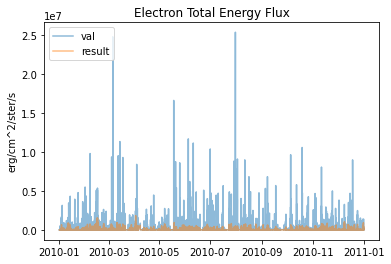

<Figure size 432x288 with 0 Axes>

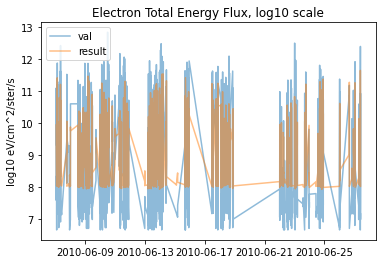

<Figure size 432x288 with 0 Axes>

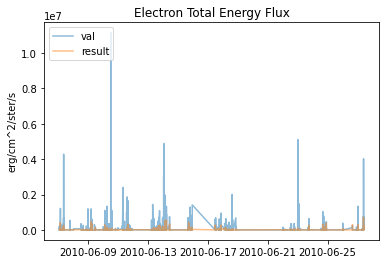

<Figure size 432x288 with 0 Axes>

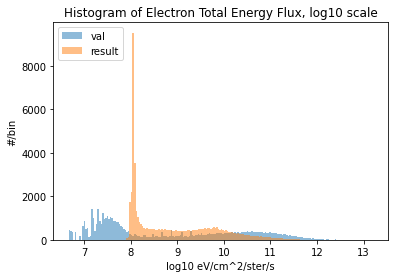

<Figure size 432x288 with 0 Axes>

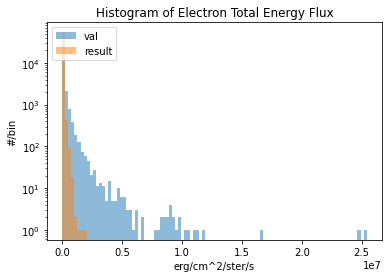

<Figure size 432x288 with 0 Axes>

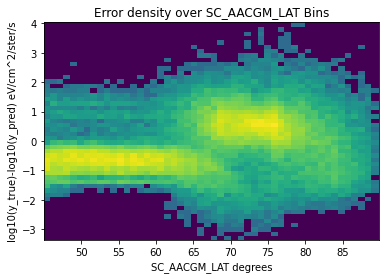

<Figure size 432x288 with 0 Axes>

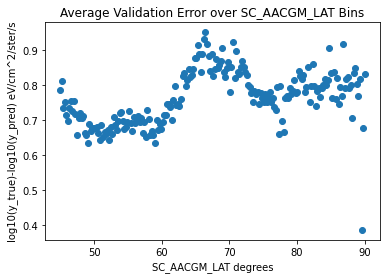

<Figure size 432x288 with 0 Axes>

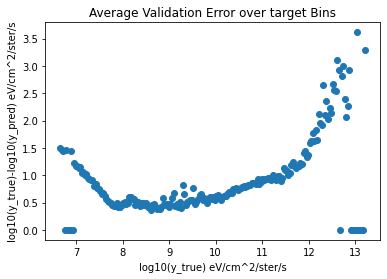

<Figure size 432x288 with 0 Axes>

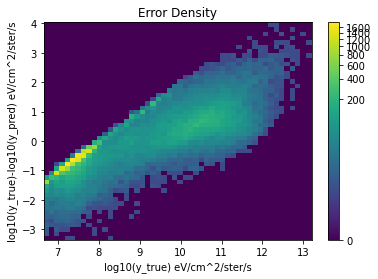

<Figure size 432x288 with 0 Axes>

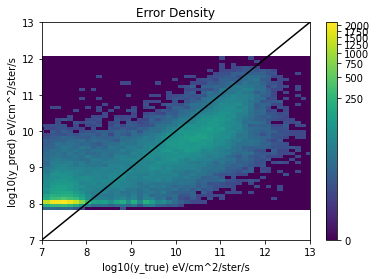

In [19]:
result_val = for_CSV_val(scaler_X, model, features, df_val, XX_test)
np.average((y_val_log-(np.array(result_val)))**2)

plt.figure()
plt.hist(y_val_log,  alpha=0.5, bins=200)
plt.hist( result_val, alpha=0.5, bins=200)
plt.show()

dpi=200
df_results = pd.DataFrame(data=result_val, index = df_val.index)

plot_model(df_results, df_val)

In [20]:
df_val

,SC_AACGM_LAT,SC_AACGM_LTIME,ELE_TOTAL_ENERGY_FLUX,ID_SC,sin_ut,cos_ut,sin_doy,cos_doy,sin_SC_AACGM_LTIME,cos_SC_AACGM_LTIME,...,AE_5min,AL_5min,AU_5min,SymH_5min,PC_5min,vsw_5min,vx_5min,psw_5min,borovsky_5min,newell_5min
Datetimes,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:19:00,47.914150,18.526898,1.659327e+07,16.0,0.082808,0.996566,1.721336e-02,0.999852,-0.990501,0.137505,...,5.0,-2.0,3.0,1.0,0.03,284.9,-284.7,0.59,5676.321657,924.521137
2010-01-01 00:20:00,50.947386,18.458332,5.320492e+07,16.0,0.087156,0.996195,1.721336e-02,0.999852,-0.992810,0.119703,...,4.0,-2.0,2.0,1.0,0.01,284.5,-284.3,0.58,5288.086520,816.756143
2010-01-01 00:21:00,54.013124,18.377865,2.001838e+07,16.0,0.091502,0.995805,1.721336e-02,0.999852,-0.995111,0.098764,...,4.0,-2.0,2.0,1.0,0.01,284.5,-284.3,0.58,5288.086520,816.756143
2010-01-01 00:23:00,60.177981,18.167450,3.953466e+07,16.0,0.100188,0.994969,1.721336e-02,0.999852,-0.999039,0.043824,...,4.0,-2.0,2.0,1.0,0.01,284.5,-284.3,0.58,5288.086520,816.756143
2010-01-01 00:24:00,63.235319,18.028581,1.594093e+07,16.0,0.104528,0.994522,1.721336e-02,0.999852,-0.999972,0.007482,...,4.0,-2.0,2.0,1.0,0.01,284.5,-284.3,0.58,5288.086520,816.756143
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2010-12-31 23:31:00,68.450826,7.822696,2.549013e+09,16.0,-0.126199,0.992005,6.432491e-16,1.000000,0.888293,-0.459277,...,45.0,-37.0,8.0,-17.0,0.14,326.4,-326.3,0.93,17796.824816,3843.449351
2010-12-31 23:32:00,65.521668,7.655316,5.390875e+08,16.0,-0.121869,0.992546,6.432491e-16,1.000000,0.907560,-0.419923,...,45.0,-37.0,8.0,-17.0,0.14,326.4,-326.3,0.93,17796.824816,3843.449351
2010-12-31 23:33:00,62.542403,7.516872,2.055009e+09,16.0,-0.117537,0.993068,6.432491e-16,1.000000,0.922180,-0.386761,...,45.0,-37.0,8.0,-17.0,0.14,326.4,-326.3,0.93,17796.824816,3843.449351


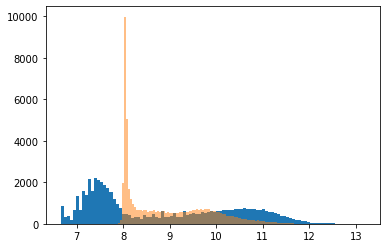

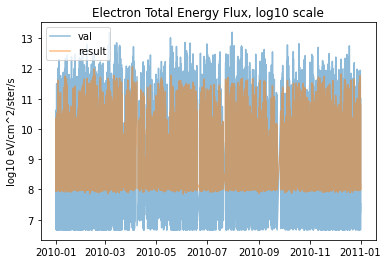

<Figure size 432x288 with 0 Axes>

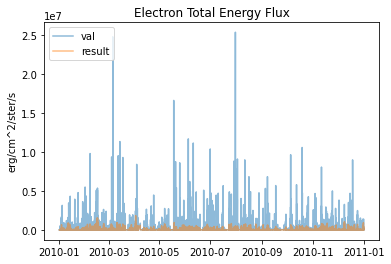

<Figure size 432x288 with 0 Axes>

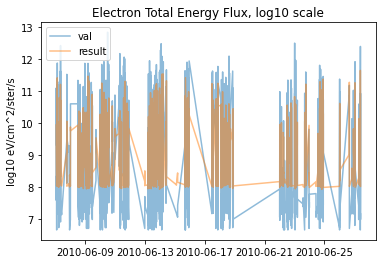

<Figure size 432x288 with 0 Axes>

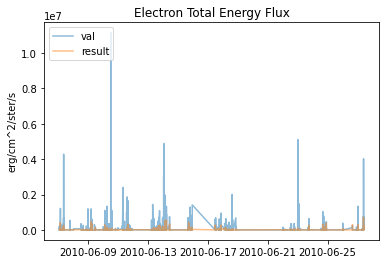

<Figure size 432x288 with 0 Axes>

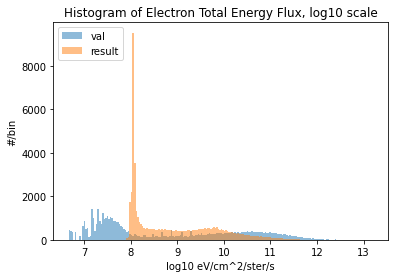

<Figure size 432x288 with 0 Axes>

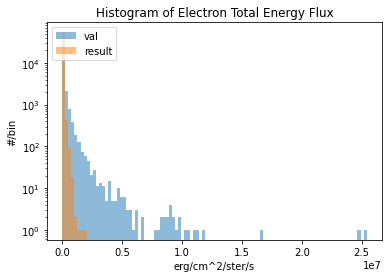

<Figure size 432x288 with 0 Axes>

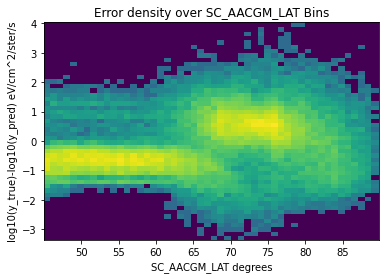

<Figure size 432x288 with 0 Axes>

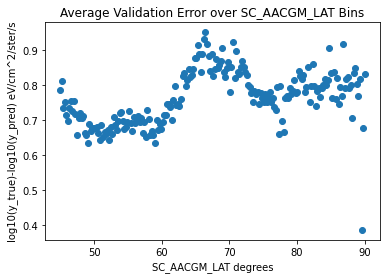

<Figure size 432x288 with 0 Axes>

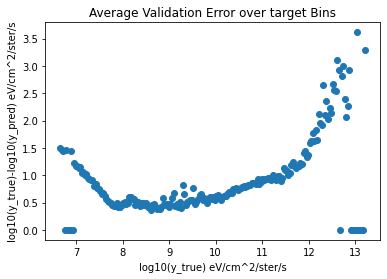

<Figure size 432x288 with 0 Axes>

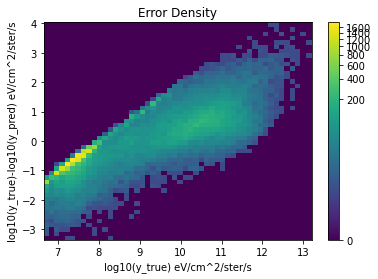

<Figure size 432x288 with 0 Axes>

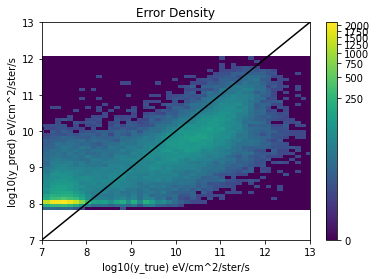

In [21]:
result_val = for_CSV_val(scaler_X, model, features, df_val, XX_test)
np.average((y_val_log-(np.array(result_val)))**2)

plt.figure()
plt.hist(y_val_log,  alpha=1, bins=100)
plt.hist( result_val, alpha=0.5, bins=100)
plt.show()

dpi=200
df_results = pd.DataFrame(data=result_val, index = df_val.index)

plot_model(df_results, df_val)

In [22]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
# model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})


history = model.fit(training_generator, 
                    validation_data=validation_generator,
                    batch_size=params['batch_size'],epochs=100,#verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=60)], use_multiprocessing=True,
                     workers=6)#

Epoch 1/100
7180/7180 [==============================] - 3299s 460ms/step - loss: 928.5839 - custom_mse: 1.6961 - val_loss: 25.1422 - val_custom_mse: 0.8151
Epoch 2/100
7180/7180 [==============================] - 3303s 460ms/step - loss: 867.6605 - custom_mse: 1.6482 - val_loss: 24.4314 - val_custom_mse: 0.7917
Epoch 3/100
7180/7180 [==============================] - 3300s 460ms/step - loss: 1038.1366 - custom_mse: 1.7851 - val_loss: 24.3183 - val_custom_mse: 0.7924
Epoch 4/100
7180/7180 [==============================] - 3299s 459ms/step - loss: 903.6179 - custom_mse: 1.6783 - val_loss: 26.8739 - val_custom_mse: 0.8583
Epoch 5/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 822.4468 - custom_mse: 1.5333 - val_loss: 23.9177 - val_custom_mse: 0.7716
Epoch 6/100
7180/7180 [==============================] - 3294s 459ms/step - loss: 850.4374 - custom_mse: 1.5795 - val_loss: 24.5695 - val_custom_mse: 0.7880
Epoch 7/100
7180/7180 [==============================] - 

7180/7180 [==============================] - 3293s 459ms/step - loss: 858.0456 - custom_mse: 1.5318 - val_loss: 24.1609 - val_custom_mse: 0.7873
Epoch 9/100
7180/7180 [==============================] - 3291s 458ms/step - loss: 841.5032 - custom_mse: 1.5498 - val_loss: 44.1856 - val_custom_mse: 1.5908
Epoch 10/100
7180/7180 [==============================] - 3293s 459ms/step - loss: 835.8619 - custom_mse: 1.5519 - val_loss: 23.9754 - val_custom_mse: 0.7810
Epoch 11/100
7180/7180 [==============================] - 3293s 459ms/step - loss: 834.9324 - custom_mse: 1.5540 - val_loss: 25.0067 - val_custom_mse: 0.8030
Epoch 12/100
7180/7180 [==============================] - 3291s 458ms/step - loss: 856.8591 - custom_mse: 1.6029 - val_loss: 25.8058 - val_custom_mse: 0.8275
Epoch 13/100
7180/7180 [==============================] - 3291s 458ms/step - loss: 807.8638 - custom_mse: 1.4991 - val_loss: 24.0164 - val_custom_mse: 0.7784
Epoch 14/100
7180/7180 [==============================] - 3294s 45

7180/7180 [==============================] - 3296s 459ms/step - loss: 882.9101 - custom_mse: 1.6188 - val_loss: 23.4956 - val_custom_mse: 0.7558
Epoch 18/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 840.2059 - custom_mse: 1.5704 - val_loss: 24.1940 - val_custom_mse: 0.7736
Epoch 19/100
7180/7180 [==============================] - 3293s 459ms/step - loss: 818.8948 - custom_mse: 1.5144 - val_loss: 23.2927 - val_custom_mse: 0.7434
Epoch 20/100
7180/7180 [==============================] - 3293s 459ms/step - loss: 808.4343 - custom_mse: 1.4958 - val_loss: 25.6452 - val_custom_mse: 0.8023
Epoch 21/100
7180/7180 [==============================] - 3292s 458ms/step - loss: 824.6140 - custom_mse: 1.5283 - val_loss: 23.8684 - val_custom_mse: 0.7713
Epoch 22/100
7180/7180 [==============================] - 3292s 459ms/step - loss: 833.8204 - custom_mse: 1.5432 - val_loss: 23.8201 - val_custom_mse: 0.7672
Epoch 23/100
7180/7180 [==============================] - 3291s 4

7180/7180 [==============================] - 3290s 458ms/step - loss: 809.6630 - custom_mse: 1.4894 - val_loss: 25.5340 - val_custom_mse: 0.8216
Epoch 26/100
7180/7180 [==============================] - 3293s 459ms/step - loss: 805.9504 - custom_mse: 1.4801 - val_loss: 23.6729 - val_custom_mse: 0.7519
Epoch 27/100
7180/7180 [==============================] - 3295s 459ms/step - loss: 802.5523 - custom_mse: 1.4850 - val_loss: 25.2545 - val_custom_mse: 0.8531
Epoch 28/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 882.5334 - custom_mse: 1.6161 - val_loss: 23.7269 - val_custom_mse: 0.7671
Epoch 29/100
7180/7180 [==============================] - 3299s 459ms/step - loss: 850.2248 - custom_mse: 1.5639 - val_loss: 26.5791 - val_custom_mse: 0.8689
Epoch 30/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 843.3543 - custom_mse: 1.5589 - val_loss: 23.6868 - val_custom_mse: 0.7709
Epoch 31/100
7180/7180 [==============================] - 3299s 4

7180/7180 [==============================] - 3301s 460ms/step - loss: 817.6215 - custom_mse: 1.5175 - val_loss: 30.2993 - val_custom_mse: 0.9244
Epoch 34/100
7180/7180 [==============================] - 3299s 460ms/step - loss: 836.2974 - custom_mse: 1.5535 - val_loss: 25.3325 - val_custom_mse: 0.8248
Epoch 35/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 826.3179 - custom_mse: 1.5230 - val_loss: 25.3684 - val_custom_mse: 0.8262
Epoch 36/100
7180/7180 [==============================] - 3299s 460ms/step - loss: 824.7561 - custom_mse: 1.4990 - val_loss: 22.6042 - val_custom_mse: 0.7357
Epoch 37/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 821.4724 - custom_mse: 1.4925 - val_loss: 24.0242 - val_custom_mse: 0.7848
Epoch 38/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 794.5233 - custom_mse: 1.4684 - val_loss: 23.6450 - val_custom_mse: 0.7603
Epoch 39/100
7180/7180 [==============================] - 3297s 4

7180/7180 [==============================] - 3298s 459ms/step - loss: 803.8586 - custom_mse: 1.4828 - val_loss: 23.3313 - val_custom_mse: 0.7494
Epoch 42/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 806.3428 - custom_mse: 1.4881 - val_loss: 23.4325 - val_custom_mse: 0.7587
Epoch 43/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 782.5642 - custom_mse: 1.4476 - val_loss: 23.5272 - val_custom_mse: 0.7548
Epoch 44/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 809.0757 - custom_mse: 1.4934 - val_loss: 23.7004 - val_custom_mse: 0.7699
Epoch 45/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 796.9472 - custom_mse: 1.4713 - val_loss: 23.4338 - val_custom_mse: 0.7573
Epoch 46/100
7180/7180 [==============================] - 3295s 459ms/step - loss: 793.2739 - custom_mse: 1.4628 - val_loss: 22.9774 - val_custom_mse: 0.7508
Epoch 47/100
7180/7180 [==============================] - 3293s 4

Epoch 50/100
7180/7180 [==============================] - 3291s 458ms/step - loss: 785.1237 - custom_mse: 1.4499 - val_loss: 23.2098 - val_custom_mse: 0.7448
Epoch 51/100
7180/7180 [==============================] - 3291s 458ms/step - loss: 783.9671 - custom_mse: 1.4534 - val_loss: 23.8904 - val_custom_mse: 0.7969
Epoch 52/100
7180/7180 [==============================] - 3290s 458ms/step - loss: 805.7083 - custom_mse: 1.4844 - val_loss: 24.8968 - val_custom_mse: 0.8450
Epoch 53/100
7180/7180 [==============================] - 3291s 458ms/step - loss: 780.0289 - custom_mse: 1.4510 - val_loss: 23.6106 - val_custom_mse: 0.7473
Epoch 54/100
7180/7180 [==============================] - 3292s 459ms/step - loss: 786.8704 - custom_mse: 1.4550 - val_loss: 23.5210 - val_custom_mse: 0.7512
Epoch 55/100
7180/7180 [==============================] - 3294s 459ms/step - loss: 776.6371 - custom_mse: 1.4381 - val_loss: 23.8310 - val_custom_mse: 0.7626
Epoch 56/100
7180/7180 [============================

7180/7180 [==============================] - 3297s 459ms/step - loss: 789.0410 - custom_mse: 1.4647 - val_loss: 23.6233 - val_custom_mse: 0.7669
Epoch 59/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 777.7490 - custom_mse: 1.4419 - val_loss: 23.1915 - val_custom_mse: 0.7462
Epoch 60/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 789.4067 - custom_mse: 1.4671 - val_loss: 23.8778 - val_custom_mse: 0.7785
Epoch 61/100
7180/7180 [==============================] - 3294s 459ms/step - loss: 823.4058 - custom_mse: 1.5083 - val_loss: 24.3980 - val_custom_mse: 0.7933
Epoch 62/100
7180/7180 [==============================] - 3295s 459ms/step - loss: 805.4734 - custom_mse: 1.4921 - val_loss: 22.7535 - val_custom_mse: 0.7310
Epoch 63/100
7180/7180 [==============================] - 3294s 459ms/step - loss: 781.6793 - custom_mse: 1.4447 - val_loss: 24.7590 - val_custom_mse: 0.7892
Epoch 64/100
7180/7180 [==============================] - 3294s 4

7180/7180 [==============================] - 3293s 459ms/step - loss: 768.3250 - custom_mse: 1.4250 - val_loss: 22.8505 - val_custom_mse: 0.7368
Epoch 67/100
7180/7180 [==============================] - 3292s 458ms/step - loss: 782.0928 - custom_mse: 1.4336 - val_loss: 24.4644 - val_custom_mse: 0.7907
Epoch 68/100
7180/7180 [==============================] - 3292s 459ms/step - loss: 767.8276 - custom_mse: 1.4243 - val_loss: 24.2169 - val_custom_mse: 0.7840
Epoch 69/100
7180/7180 [==============================] - 3292s 459ms/step - loss: 768.4529 - custom_mse: 1.4258 - val_loss: 23.3252 - val_custom_mse: 0.7452
Epoch 70/100
7180/7180 [==============================] - 3292s 459ms/step - loss: 774.1917 - custom_mse: 1.4354 - val_loss: 23.7079 - val_custom_mse: 0.7805
Epoch 71/100
7180/7180 [==============================] - 3292s 459ms/step - loss: 814.3602 - custom_mse: 1.5027 - val_loss: 23.6856 - val_custom_mse: 0.7685
Epoch 72/100
7180/7180 [==============================] - 3291s 4

7180/7180 [==============================] - 3289s 458ms/step - loss: 768.1813 - custom_mse: 1.4322 - val_loss: 22.9623 - val_custom_mse: 0.7447
Epoch 75/100
7180/7180 [==============================] - 3289s 458ms/step - loss: 765.7448 - custom_mse: 1.4238 - val_loss: 23.2603 - val_custom_mse: 0.7546
Epoch 76/100
7180/7180 [==============================] - 3289s 458ms/step - loss: 762.7139 - custom_mse: 1.4196 - val_loss: 23.1361 - val_custom_mse: 0.7502
Epoch 77/100
7180/7180 [==============================] - 3288s 458ms/step - loss: 764.0768 - custom_mse: 1.4223 - val_loss: 23.1253 - val_custom_mse: 0.7506
Epoch 78/100
7180/7180 [==============================] - 3290s 458ms/step - loss: 771.9540 - custom_mse: 1.4258 - val_loss: 23.1963 - val_custom_mse: 0.7560
Epoch 79/100
7180/7180 [==============================] - 3290s 458ms/step - loss: 778.5374 - custom_mse: 1.4327 - val_loss: 22.6999 - val_custom_mse: 0.7301
Epoch 80/100
7180/7180 [==============================] - 3291s 4

7180/7180 [==============================] - 3296s 459ms/step - loss: 765.3986 - custom_mse: 1.4195 - val_loss: 24.1572 - val_custom_mse: 0.7738
Epoch 83/100
7180/7180 [==============================] - 3295s 459ms/step - loss: 767.0492 - custom_mse: 1.4219 - val_loss: 23.1868 - val_custom_mse: 0.7473
Epoch 84/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 765.6309 - custom_mse: 1.4192 - val_loss: 22.9318 - val_custom_mse: 0.7370
Epoch 85/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 761.7496 - custom_mse: 1.4149 - val_loss: 22.4698 - val_custom_mse: 0.7230
Epoch 86/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 764.1951 - custom_mse: 1.4210 - val_loss: 23.1124 - val_custom_mse: 0.7204
Epoch 87/100
7180/7180 [==============================] - 3297s 459ms/step - loss: 759.5876 - custom_mse: 1.4156 - val_loss: 23.4323 - val_custom_mse: 0.7775
Epoch 88/100
7180/7180 [==============================] - 3295s 4

Epoch 91/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 765.0661 - custom_mse: 1.4167 - val_loss: 22.4868 - val_custom_mse: 0.7178
Epoch 92/100
7180/7180 [==============================] - 3296s 459ms/step - loss: 762.7635 - custom_mse: 1.4196 - val_loss: 22.5825 - val_custom_mse: 0.7281
Epoch 93/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 765.8778 - custom_mse: 1.4157 - val_loss: 23.2092 - val_custom_mse: 0.7525
Epoch 94/100
7180/7180 [==============================] - 3298s 459ms/step - loss: 759.5387 - custom_mse: 1.4140 - val_loss: 23.0173 - val_custom_mse: 0.7397
Epoch 95/100
7180/7180 [==============================] - 3294s 459ms/step - loss: 767.9743 - custom_mse: 1.4177 - val_loss: 23.0598 - val_custom_mse: 0.7385
Epoch 96/100
7180/7180 [==============================] - 3294s 459ms/step - loss: 770.5582 - custom_mse: 1.4282 - val_loss: 23.5000 - val_custom_mse: 0.7613
Epoch 97/100
7180/7180 [============================

7180/7180 [==============================] - 3292s 458ms/step - loss: 768.4286 - custom_mse: 1.4236 - val_loss: 22.6546 - val_custom_mse: 0.7376
Epoch 100/100
7180/7180 [==============================] - 3293s 459ms/step - loss: 759.1165 - custom_mse: 1.4129 - val_loss: 23.3240 - val_custom_mse: 0.7557


In [23]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})


INFO:tensorflow:Assets written to: mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f/assets


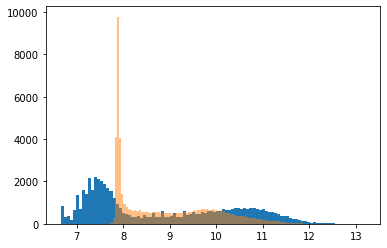

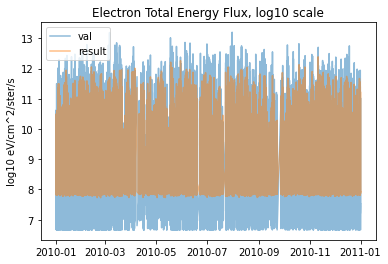

<Figure size 432x288 with 0 Axes>

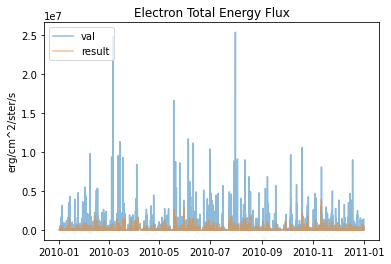

<Figure size 432x288 with 0 Axes>

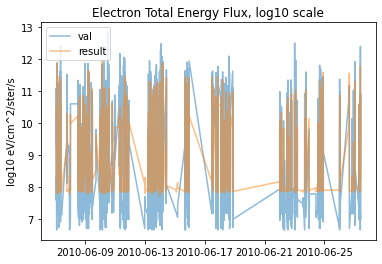

<Figure size 432x288 with 0 Axes>

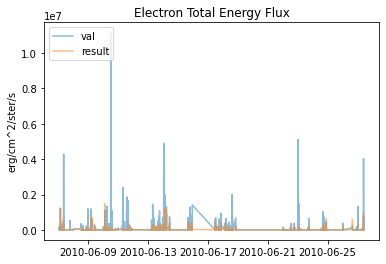

<Figure size 432x288 with 0 Axes>

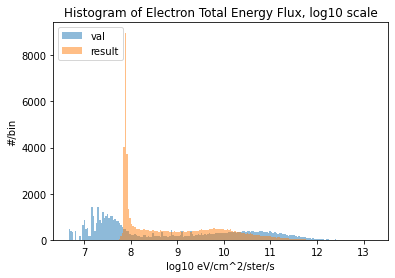

<Figure size 432x288 with 0 Axes>

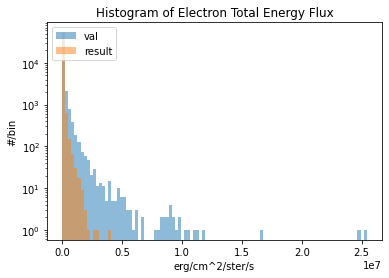

<Figure size 432x288 with 0 Axes>

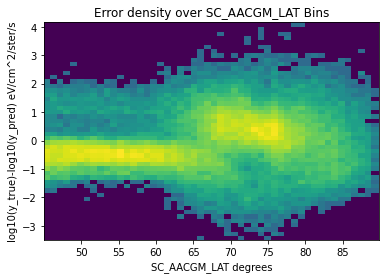

<Figure size 432x288 with 0 Axes>

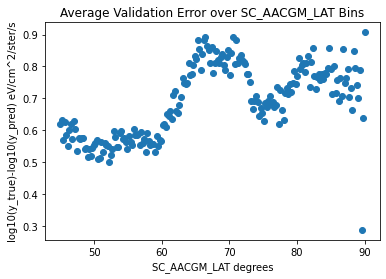

<Figure size 432x288 with 0 Axes>

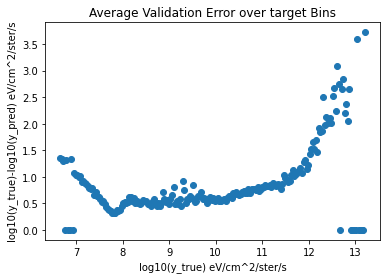

<Figure size 432x288 with 0 Axes>

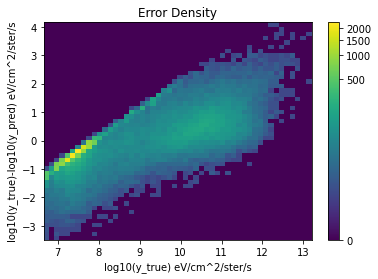

<Figure size 432x288 with 0 Axes>

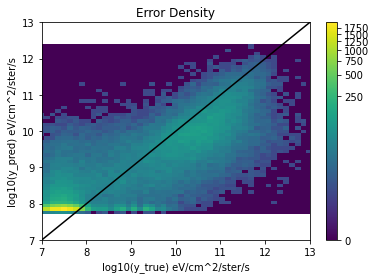

In [25]:
result_val = for_CSV_val(scaler_X, model, features, df_val, XX_test)
np.average((y_val_log-(np.array(result_val)))**2)

plt.figure()
plt.hist(y_val_log,  alpha=1, bins=100)
plt.hist( result_val, alpha=0.5, bins=100)
plt.show()

dpi=200
df_results = pd.DataFrame(data=result_val, index = df_val.index)

plot_model(df_results, df_val)

In [26]:

from ovationpyme.ovation_prime import FluxEstimator,AverageEnergyEstimator,BinCorrector
from ovationpyme.ovation_utilities import calc_avg_solarwind
from ovationpyme.ovation_plotting import latlt2polar,polar2dial,pcolor_flux
    
def plot_model_multiple_polar(models,model_names, scalars, model_input_keys, dims, model_pipeline,df_val_inputs):
    for pt in range(0,df_val_inputs.shape[0]):
        dt =   df_val_inputs.index[pt]#  datetime.datetime( df_val_inputs.index[pt].date().timetuple().tm_year , df_val_inputs.index[pt].date().timetuple().tm_mon,
                                 # df_val_inputs.index[pt].date().timetuple().tm_mday, 
                                 # df_val_inputs.index[pt].date().timetuple().tm_hour, )
#                                   df_val_inputs.index[pt].date().timetuple().tm_min) #year,month,day,hour,minute)
        print(pt,df_val_inputs.index[pt])
        print(dt)      
        
        num = len(models)

        subplotlist=[]
        fig= plt.figure(figsize=(12,16))
        subplotlist.append(plt.subplot2grid((6,2), (0,0), rowspan=1,colspan=1,polar=True) )
        subplotlist.append( plt.subplot2grid((6,2), (0, 1), rowspan=1,colspan=1,polar=True) ) 
        subplotlist.append( plt.subplot2grid((6,2), (1,0), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (1, 1), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (2,0), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (2, 1), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (3,0), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (3, 1), rowspan=1,colspan=1,polar=True))    
        subplotlist.append( plt.subplot2grid((6,2), (4,0), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (4, 1), rowspan=1,colspan=1,polar=True))   
        subplotlist.append( plt.subplot2grid((6,2), (5,0), rowspan=1,colspan=1,polar=True))
        subplotlist.append( plt.subplot2grid((6,2), (5, 1), rowspan=1,colspan=1,polar=True))
        mark= ['s', 'o', 'D', 'v']

#         %matplotlib inline
#         plt.ioff()

        pcolor_kwargs = {'cmap':'gnuplot','vmin':7.5,'vmax':13}

        for i in range(0,num):
            print(model_names[i])
            model = models[i]
            X_test=df_val_inputs[model_input_keys[i]][pt:pt+1]

            
            if (dims[i] == 2):
                
                X_test= scalars[i].transform(X_test.values)
                results = model.predict(X_test)
                mlatgridN = np.linspace(90,45,num=128)
                mltgridN =  np.linspace(0,24,num=128)   
                flux = 10**(results[0,:,:,0])*1.60218e-12*3.14159

                ax=subplotlist[i+1]
                mappableN = pcolor_flux(ax,mlatgridN,mltgridN,np.log10(flux/1.60218e-12),'N',**pcolor_kwargs)

                ax.set_title(model_names[i],fontweight="bold", fontsize='medium',pad=10)


                ax.set_theta_zero_location('S')
                theta_label_values = np.array([0.,3.,6.,9.,12.,15.,18.,21.])*180./12
                theta_labels = ['%d:00' % (int(th/180.*12)) for th in theta_label_values.flatten().tolist()]
                ax.set_thetagrids(theta_label_values,labels=theta_labels)

                r_label_values = 90.-np.array([80.,70.,60.,50.])
                r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
                ax.set_rgrids(r_label_values,labels=r_labels)
                ax.set_rlim([0.,45.])

#                 ax.scatter(np.linspace(90,45,128),np.log10(flux[:,int(23/24*128)]/1.60218e-12), marker=mark[3])
            else:
                
                
                mlatgridN = np.linspace(90,45,num=128)
                mltgridN =  np.linspace(0,24,num=128)          

                #################################
                #
                #ML model
                ##########################
                model_input = np.zeros((128,128,len(model_input_keys[i])))
                flux = np.zeros((mlatgridN.shape[0], mltgridN.shape[0]))


                for j in range(0,mlatgridN.shape[0]):
                    for k in range(0,mltgridN.shape[0]):        
                        #calc cos and sin
                        rads = mltgridN[k]*15*3.14159/180.
                        model_input[j,k,:]=X_test.values
                        if ( (model_pipeline[i] ==1) 
                            or (len(model_input_keys[i])==33 or len(model_input_keys[i])==59)  
                           ) :
                            model_input[j,k,7]=np.cos(rads)
                            model_input[j,k,6]=np.sin(rads)
                            model_input[j,k,0]=mlatgridN[j]
                        elif  ( len(model_input_keys[i])== 72)  :
                            model_input[j,k,72-6]=np.cos(rads)
                            model_input[j,k,72-5]=np.sin(rads)
                            model_input[j,k,0]=mlatgridN[j] 
                        else: 
                            model_input[j,k,142]=np.cos(rads)
                            model_input[j,k,143]=np.sin(rads)
                            model_input[j,k,0]=mlatgridN[j]          
                shaped = np.reshape(model_input,(128*128,len(model_input_keys[i])))
                X_val_scaled = scalars[i].transform(shaped)
                #get auroral region and flux
                flux = np.log10(10**(np.reshape(model.predict(X_val_scaled),(128,128)))*3.14159)
        
                ax=subplotlist[i+1]
                mappableN = pcolor_flux(ax,mlatgridN,mltgridN,flux,'N',**pcolor_kwargs)

                ax.set_title(model_names[i],fontweight="bold", fontsize='medium',pad=10)


                ax.set_theta_zero_location('S')
                theta_label_values = np.array([0.,3.,6.,9.,12.,15.,18.,21.])*180./12
                theta_labels = ['%d:00' % (int(th/180.*12)) for th in theta_label_values.flatten().tolist()]
                ax.set_thetagrids(theta_label_values,labels=theta_labels)

                r_label_values = 90.-np.array([80.,70.,60.,50.])
                r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
                ax.set_rgrids(r_label_values,labels=r_labels)
                ax.set_rlim([0.,45.])

#                 ax.scatter(np.linspace(90,45,128),np.log10(flux[:,int(23/24*128)]/1.60218e-12), marker=mark[3])



#         range1=np.min(np.min([-df_val['AL'].values,df_val['AE'].values,df_val['AU'].values]))
#         range2=np.max(np.max([-df_val['AL'].values,df_val['AE'].values,df_val['AU'].values]))


        ###########################3
        # Ovation128
        ########################

        auroral_types = ['diff','mono','wave','ions']
        # axS = f.add_subplot(122,projection='polar')
        for jj in range(0,3):
            atype = auroral_types[jj]
            jtype ="energy"
            bincorrect = True
            combine_hemispheres = True
            dtstr = dt.strftime('%Y%m%d %H:%M')
            if jtype=='average energy':
                estimator = AverageEnergyEstimator(atype)
                get_precip_for_time = estimator.get_eavg_for_time
            else:
                estimator = FluxEstimator(atype,jtype)
                get_precip_for_time = estimator.get_flux_for_time


            tflux_kwargs = {'combine_hemispheres':combine_hemispheres,
                            'return_dF':True}
            fluxtupleN = get_precip_for_time(dt,hemi='N',**tflux_kwargs)
            mlatgridN,mltgridN,fluxgridN,newell_coupling = fluxtupleN
            fluxtupleS = get_precip_for_time(dt,hemi='S',**tflux_kwargs)
            mlatgridS,mltgridS,fluxgridS,newell_coupling = fluxtupleS

            if bincorrect:
                bcN = BinCorrector(mlatgridN,mltgridN)
                fluxgridN = bcN.fix(fluxgridN)
                bcS = BinCorrector(mlatgridS,mltgridS)
                fluxgridS = bcS.fix(fluxgridS)
                print("Correction Applied")

            if jj== 0:
                fluxgridN_sum = fluxgridN
                fluxgridS_sum = fluxgridS
            else:
                fluxgridN_sum = fluxgridN_sum+fluxgridN
                fluxgridS_sum = fluxgridN_sum+fluxgridS

        mappableN = pcolor_flux( subplotlist[0],mlatgridN,mltgridN,np.log10(fluxgridN_sum/1.60218e-12),'N',**pcolor_kwargs)

        subplotlist[0].set_title('OVATION Pyme',pad =10,fontweight="bold", fontsize='medium')


        subplotlist[0].set_theta_zero_location('S')
        theta_label_values = np.array([0.,3.,6.,9.,12.,15.,18.,21.])*180./12
        theta_labels = ['%d:00' % (int(th/180.*12)) for th in theta_label_values.flatten().tolist()]
        subplotlist[0].set_thetagrids(theta_label_values,labels=theta_labels,fontsize='medium', )

        r_label_values = 90.-np.array([80.,70.,60.,50.])
        r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
        subplotlist[0].set_rgrids(r_label_values,labels=r_labels)
        subplotlist[0].set_rlim([0.,45.])

#         subplotlist[0].scatter(np.ones((20))*23/24*2*3.14159 ,                   np.linspace(0,40,20)      )     

        plt.colorbar(mappableN,ax=subplotlist[i+2],label='Total Energy Flux [erg/cm^s/s]')        

        fig.tight_layout() 
#         fig.set_title('Log10 Predicted Electron Precipitation Energy Flux')
        plt.show()
    


In [27]:
def plot_model_multiple(df_results_in,model_names, y_val_log_in):
    
    
    
    num = len(df_results_in)
    names = ['Validation']
    for i in range(0,num):
        names.append(model_names[i])
    y_val_log = np.log10(10**(y_val_log_in)*3.14159)

    df_results = []
    for i in range(0,num):
        df_results.append( np.log10(10**(df_results_in[i])*3.14159))
    plt.figure()
    plt.plot(y_val_log[:],alpha = 1)
    for i in range(0,num):
        plt.plot(df_results[i],alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.title('Log10 Total Energy Flux [eV/cm^s/ster/s]')
    plt.grid()
    plt.show()
    plt.savefig("1")
    

    plt.figure()
    plt.plot(10**y_val_log[:]*1.6e-6,alpha = 1)
    for i in range(0,num):
        plt.plot(10**df_results[i]*1.6e-6,alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.grid()
    plt.show()
    
    plt.figure()
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, range=(10**6*1.6e-6,8e7), log=True,alpha = 1)
    for i in range(0,num):
        plt.hist(10**df_results[i].values*1.6e-6,bins=100,range=(10**6*1.6e-6,8e7), log=True,alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.title("Total Energy Flux Histogram")
    plt.xlabel("[erg/cm^s/ster/s]")
    plt.ylabel("#/bin")
    plt.grid()
    plt.show()
    plt.savefig("2")

    plt.figure()
    plt.hist(y_val_log.values,bins=100,range=(7,13.5),alpha = 1)
    for i in range(0,num):  
        plt.hist(df_results[i].values,bins=100,range=(7,13.5),alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.title("Log10 Total Energy Flux Histogram")
    plt.xlabel("Log10 [eV/cm^s/ster/s]")
    plt.ylabel("#/bin")
    plt.grid()
    plt.show()
    plt.savefig("3")



    plt.figure()
    plt.hist(y_val_log.values,bins=100,range=(7,13.5))
    for k in range(0,num):
        plt.hist(df_results[k].values,bins=100,range=(7,13.5),alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.ylim([0,4000])
    plt.title("Log10 Total Energy Flux Histogram")
    plt.xlabel("Log10 [eV/cm^s/ster/s]")
    plt.ylabel("#/bin")
    plt.grid()
    plt.show()
    plt.savefig("4")



    plt.figure();
    for k in range(0,num):     
        errors= y_val_log.values-df_results[k].values[:,0]
        plt.scatter(y_val_log.values,errors,s=1,alpha = 0.5)
    plt.title('Errors over target Bins')
    plt.legend(model_names, loc='upper left')                      
    plt.grid()
    plt.show()

    plt.figure();
    for k in range(0,num):
        errors= y_val_log.values-df_results[k].values[:,0]     
        bin_total = np.zeros((100))
        bin_error_total = np.zeros((100))
        for j in range(0,y_val_log.values.shape[0]):
            i = int((y_val_log[j]-7)/((14-7)/100))
            if i < 100:
                bin_total[i] = bin_total[i]+1
                bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])
        avg_error_over_hist = bin_error_total/(bin_total+.00001)
        plt.scatter(np.linspace(7,13.5,num=100),avg_error_over_hist,alpha = 0.5)
    plt.title('Average Validation Error over target Bins')    
    plt.legend(model_names, loc='upper left')
    plt.ylim([0,2.6])
    plt.ylabel("Log10 [eV/cm^s/ster/s]")
    plt.xlabel("bin #")
    plt.grid()
    plt.show()
    plt.savefig("5")


    for k in range(0,num):  
        plt.figure();

        errors= y_val_log.values-df_results[k].values[:,0]
        plt.hist2d(y_val_log.values,errors,bins=100)
        plt.title('Errors over target Bins'+model_names[k])
        plt.grid()
        plt.show()
        
    plt.figure();
    for k in range(0,num):      
        errors= y_val_log.values-df_results[k].values[:,0]     
        plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1,alpha = 0.5)
    plt.legend(model_names, loc='upper left')                      
    plt.title('Errors over SC_AACGM_LAT Bins')
    plt.grid()
    plt.show()

    plt.figure();
    for k in range(0,num):
        errors= y_val_log.values-df_results[k].values[:,0]     
        bin_total = np.zeros((100))
        bin_error_total = np.zeros((100))
        for j in range(0,y_val_log.values.shape[0]):
            i = int((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/100))
            if i < 100:
                bin_total[i] = bin_total[i]+1
                bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])
        avg_error_over_hist = bin_error_total/bin_total
        plt.scatter(np.linspace(45,90,num=100),avg_error_over_hist,alpha = 0.5)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.legend(model_names, loc='upper left')
    plt.ylim([0,1.2])
    plt.grid()
    plt.show()


<Figure size 432x288 with 0 Axes>

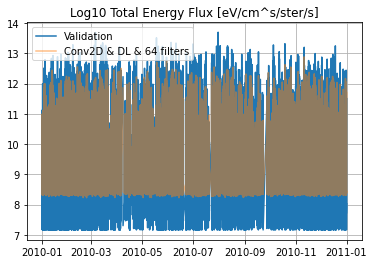

<Figure size 432x288 with 0 Axes>

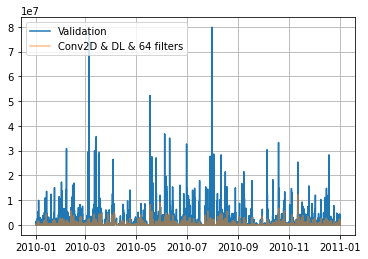

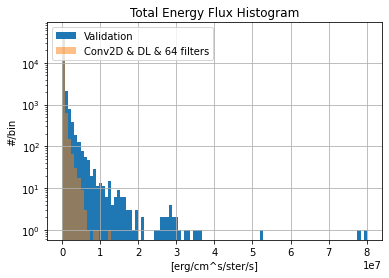

<Figure size 432x288 with 0 Axes>

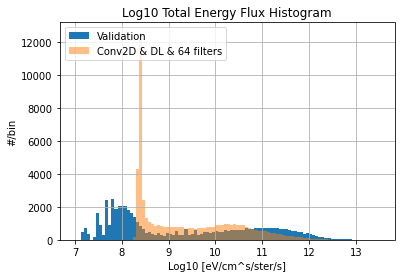

<Figure size 432x288 with 0 Axes>

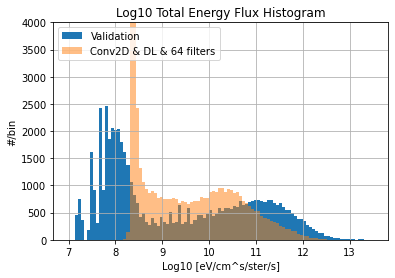

<Figure size 432x288 with 0 Axes>

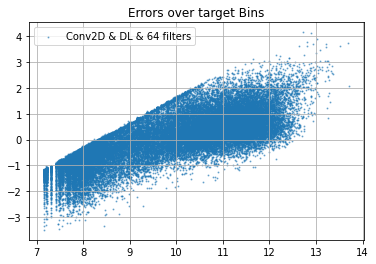

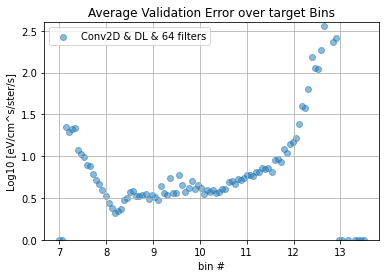

<Figure size 432x288 with 0 Axes>

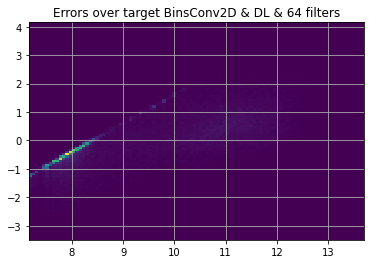

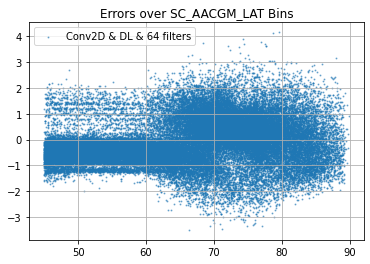

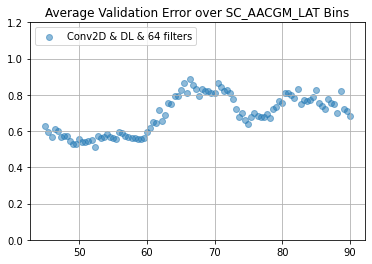

In [29]:
plot_model_multiple([df_results],['Conv2D & DL & 64 filters'],y_val_log)

In [31]:
# filename = '../ModelScalar_X_pipeline1_145.pkl'
# scaler_X = pickle.load( open(filename,"rb"))
keys=['ID_SC', 'sin_ut','cos_ut', 'sin_doy', 'cos_doy', 
                     'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 
    'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr',
    'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr',
    'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr',
    'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr',
    'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr',
    'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr',
    'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'AE_45min', 
    'AL_45min', 'AU_45min', 'SymH_45min', 'PC_45min', 'vsw_45min', 'vx_45min', 'psw_45min', 'borovsky_45min', 
    'newell_45min', 'F107_30min', 'Bz_30min', 'By_30min', 'Bx_30min', 'AE_30min', 'AL_30min', 'AU_30min', 
    'SymH_30min', 'PC_30min', 'vsw_30min', 'vx_30min', 'psw_30min', 'borovsky_30min', 'newell_30min', 
    'F107_15min', 'Bz_15min', 'By_15min', 'Bx_15min', 'AE_15min', 'AL_15min', 'AU_15min', 'SymH_15min', 
    'PC_15min', 'vsw_15min', 'vx_15min', 'psw_15min', 'borovsky_15min', 'newell_15min', 'F107_10min', 
    'Bz_10min', 'By_10min', 'Bx_10min', 'AE_10min', 'AL_10min', 'AU_10min', 'SymH_10min', 'PC_10min', 
    'vsw_10min', 'vx_10min', 'psw_10min', 'borovsky_10min', 'newell_10min', 'F107_5min', 'Bz_5min', 'By_5min', 
    'Bx_5min', 'AE_5min', 'AL_5min', 'AU_5min', 'SymH_5min', 'PC_5min', 'vsw_5min', 'vx_5min', 'psw_5min', 
    'borovsky_5min', 'newell_5min'
]
X_val = (df_val[keys])
X_val_scaled = scaler_X.transform(df_val[keys].values)

0 2010-01-10 17:13:00
2010-01-10 17:13:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


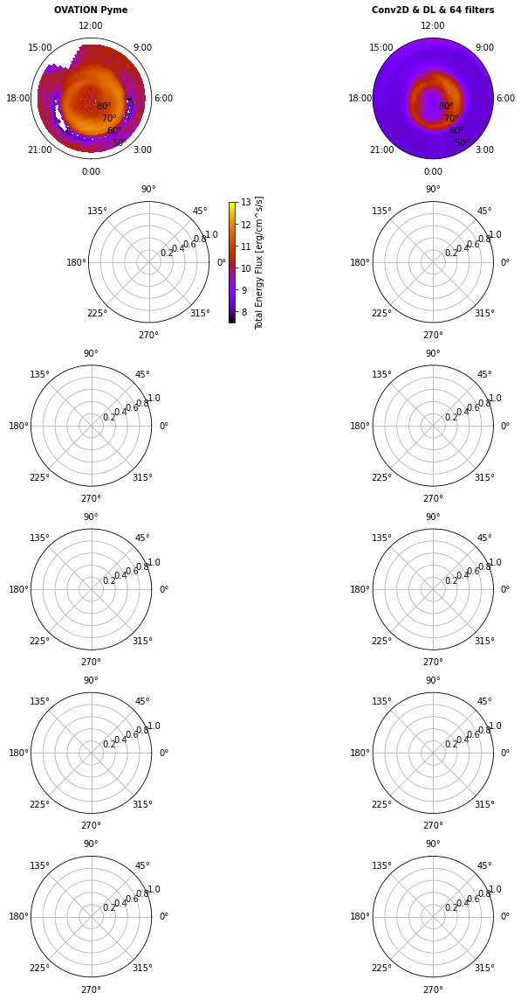

1 2010-01-30 08:01:00
2010-01-30 08:01:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


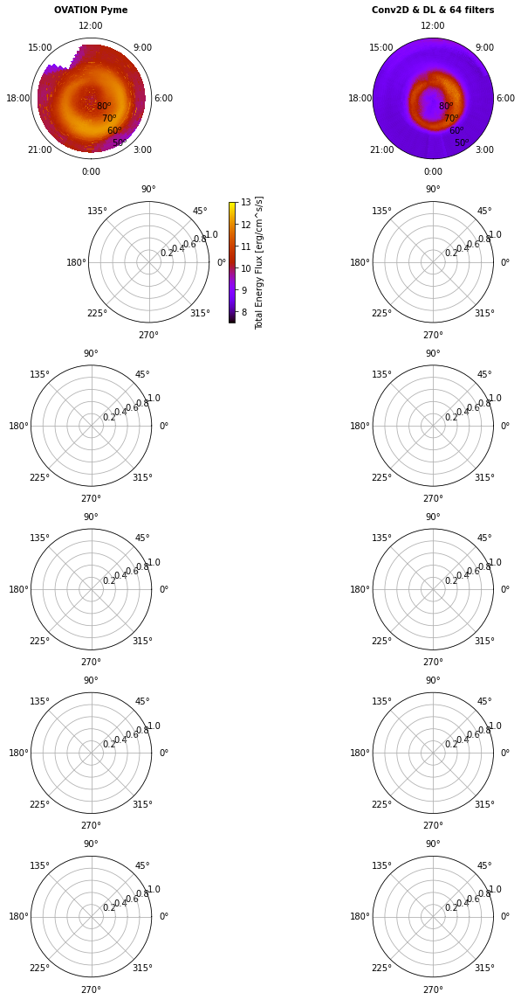

2 2010-02-14 22:35:00
2010-02-14 22:35:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


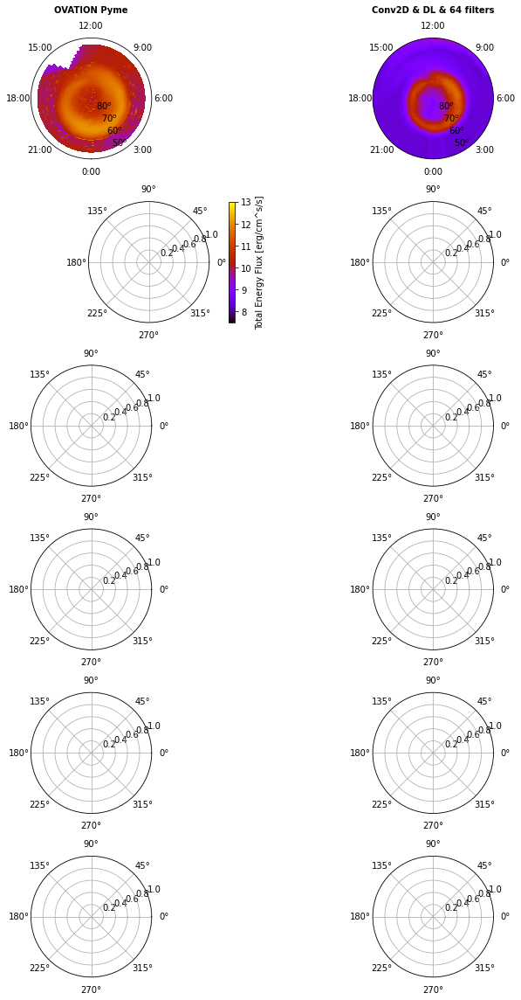

3 2010-02-25 23:33:00
2010-02-25 23:33:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


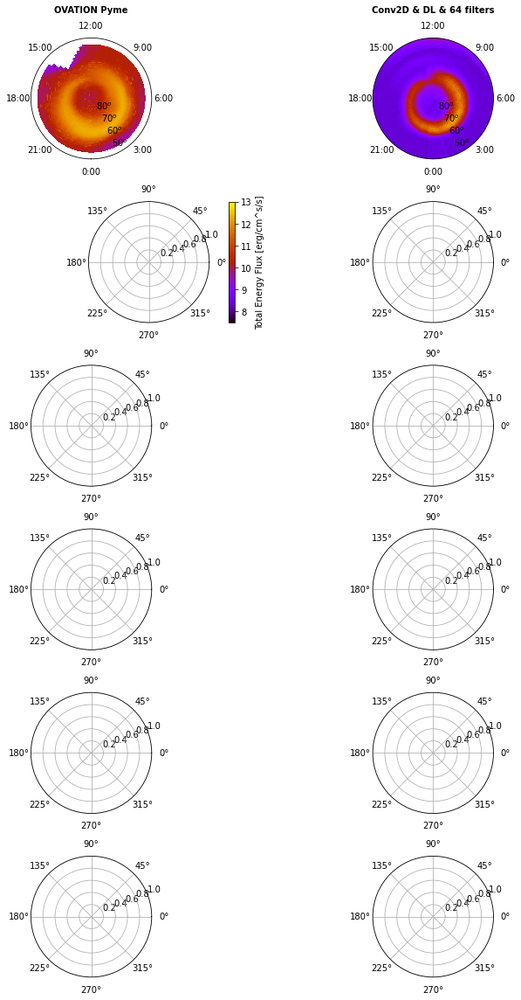

4 2010-03-13 05:54:00
2010-03-13 05:54:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


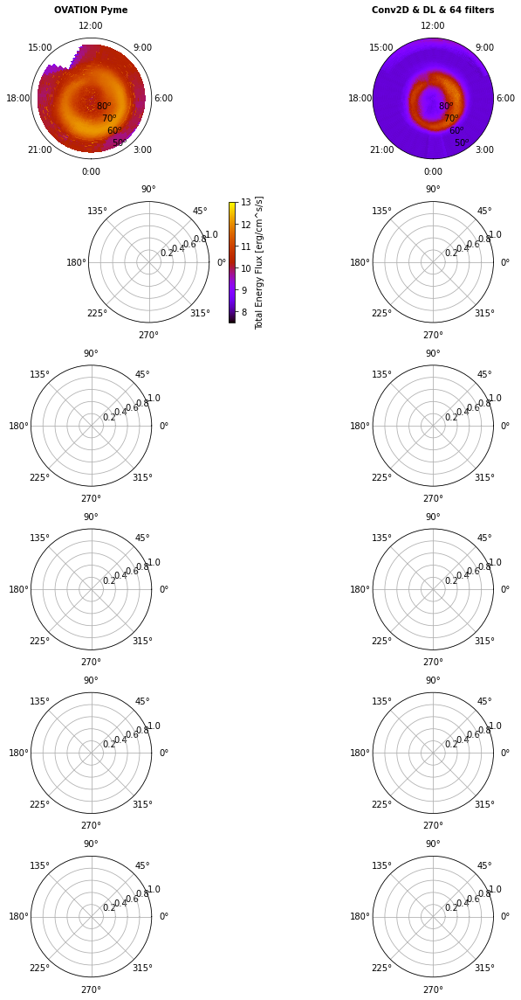

5 2010-03-28 08:34:00
2010-03-28 08:34:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


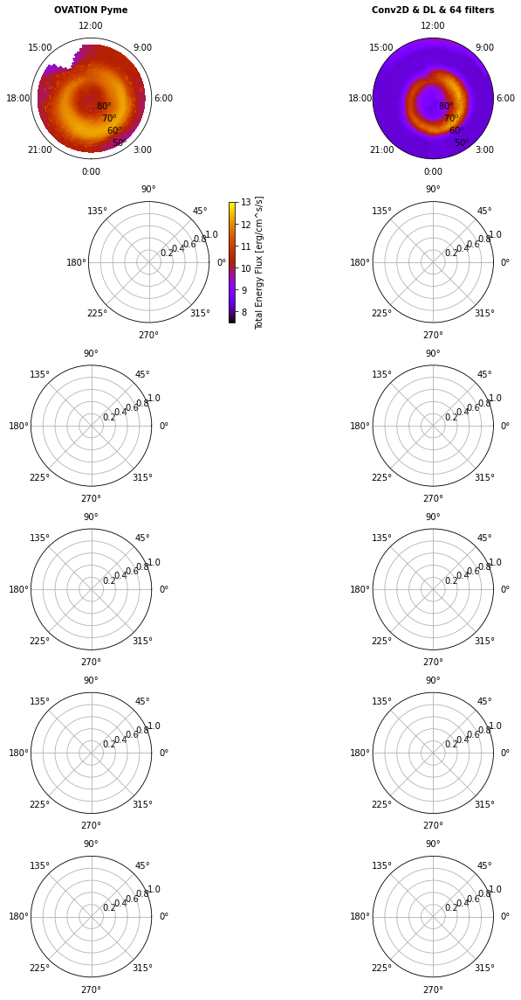

6 2010-05-10 01:58:00
2010-05-10 01:58:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


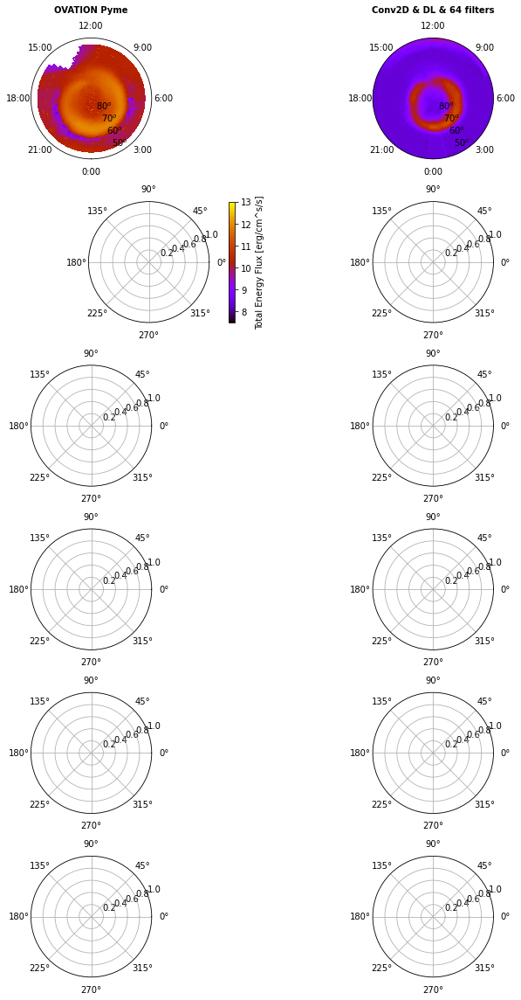

7 2010-06-05 03:09:00
2010-06-05 03:09:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


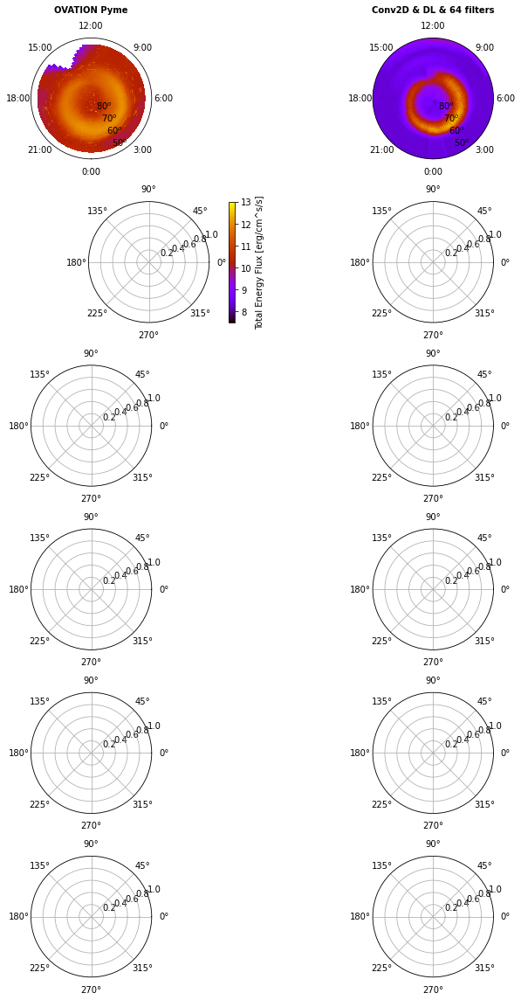

8 2010-07-04 18:27:00
2010-07-04 18:27:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


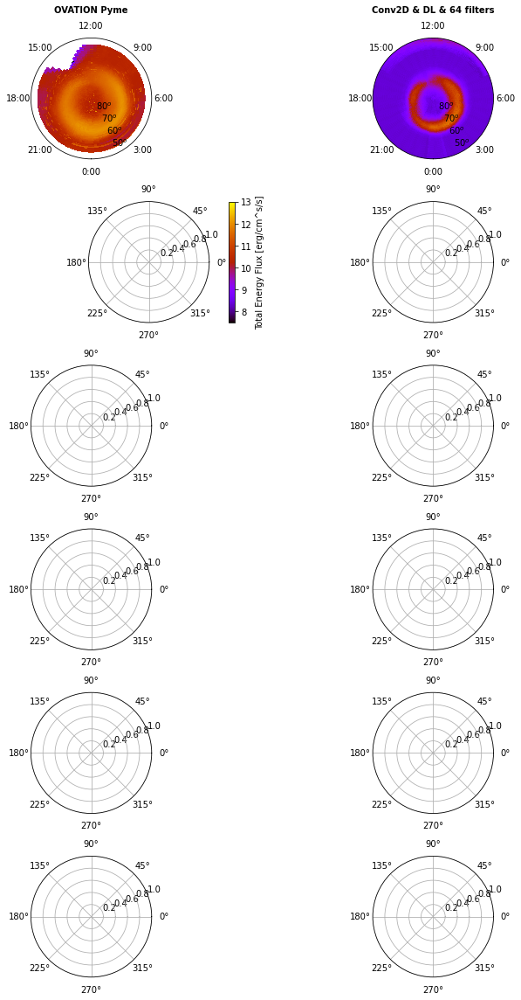

9 2010-08-01 18:29:00
2010-08-01 18:29:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


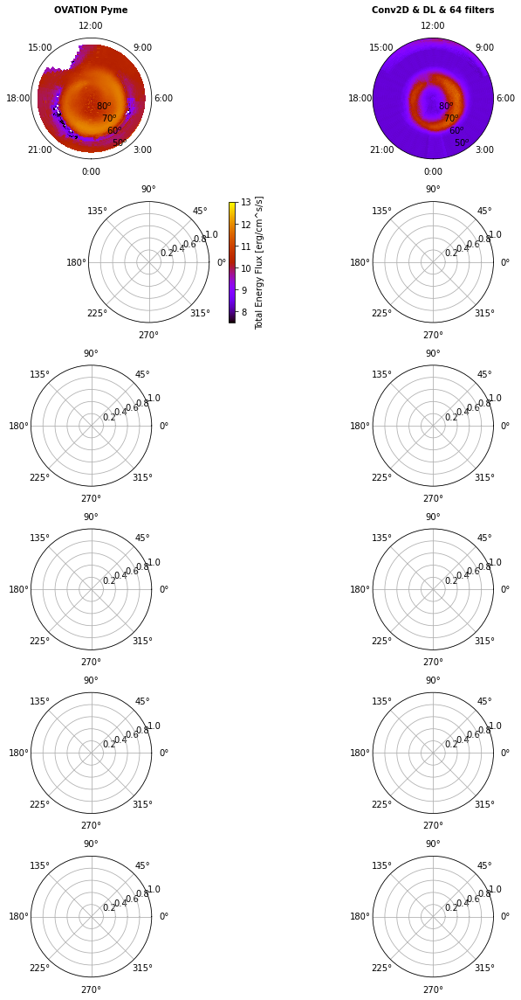

10 2010-08-20 09:07:00
2010-08-20 09:07:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


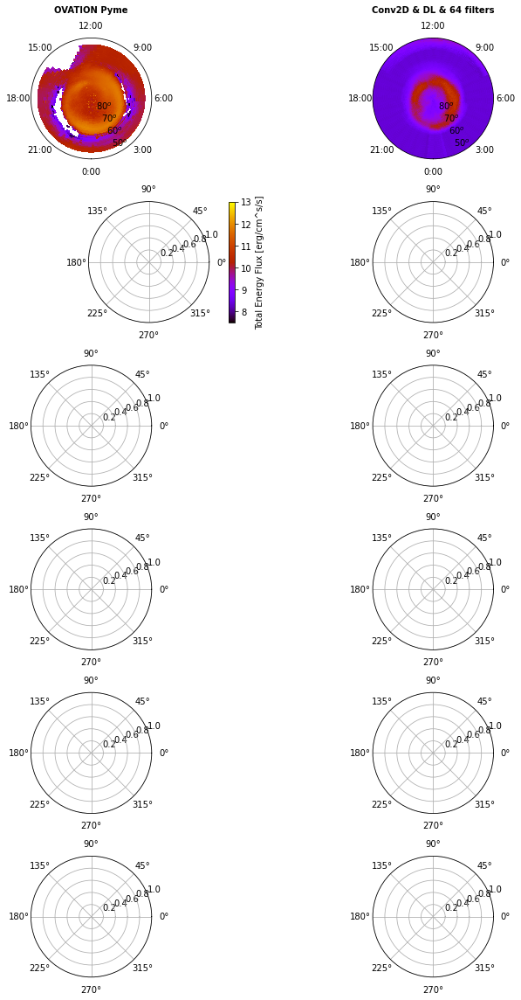

11 2010-10-02 20:27:00
2010-10-02 20:27:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


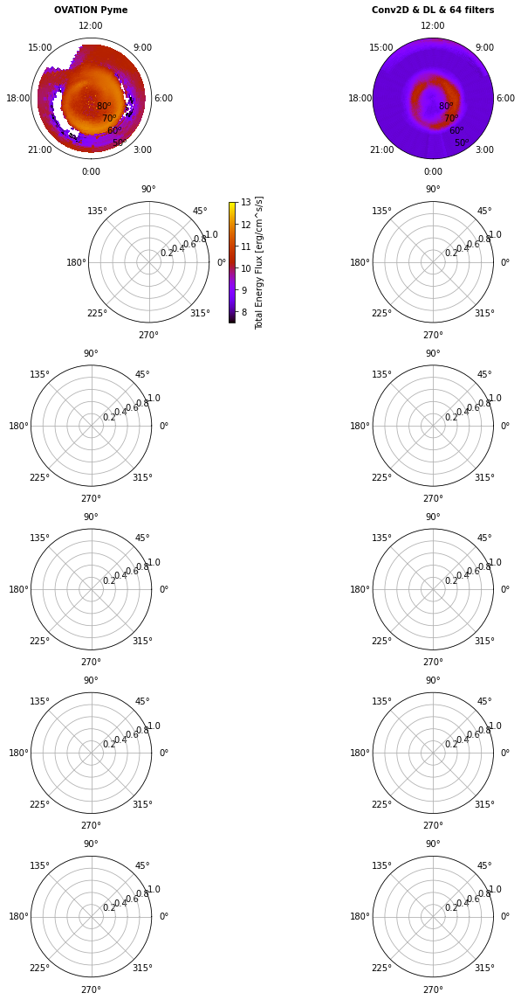

12 2010-11-08 00:33:00
2010-11-08 00:33:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


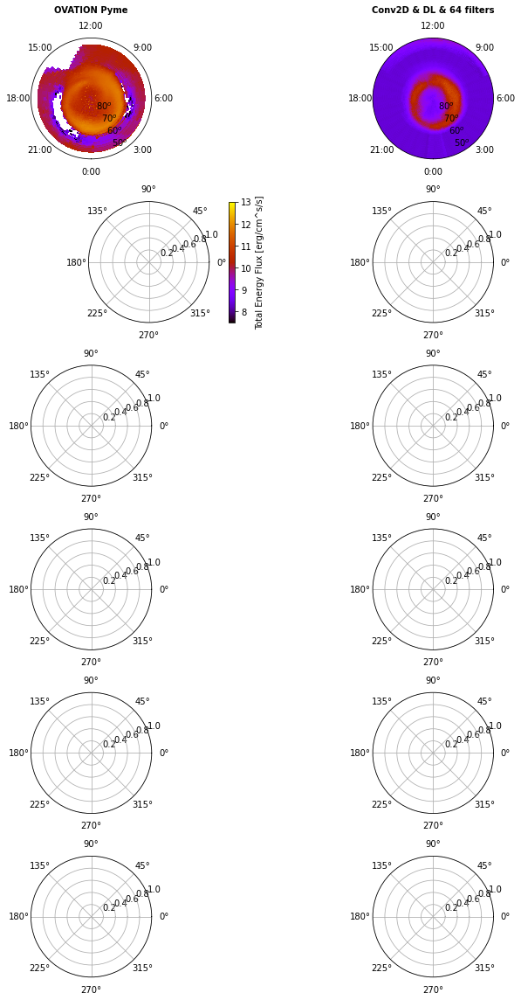

13 2010-11-25 10:35:00
2010-11-25 10:35:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


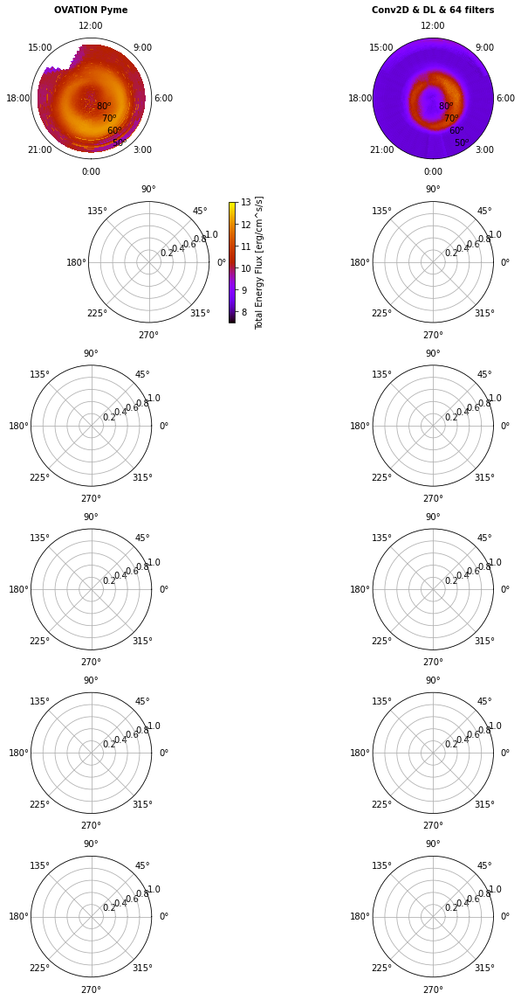

14 2010-12-12 14:57:00
2010-12-12 14:57:00
Conv2D & DL & 64 filters


/usr/local/lib/python3.6/dist-packages/ovationpyme-0.1.0-py3.6.egg/ovationpyme/ovation_plotting.py:54: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  mappable = ax.pcolormesh(thetagrid,rgrid,fluxgrid,**pcolor_kwargs)


Correction Applied
Correction Applied
Correction Applied


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:171: RuntimeWarning: divide by zero encountered in log10


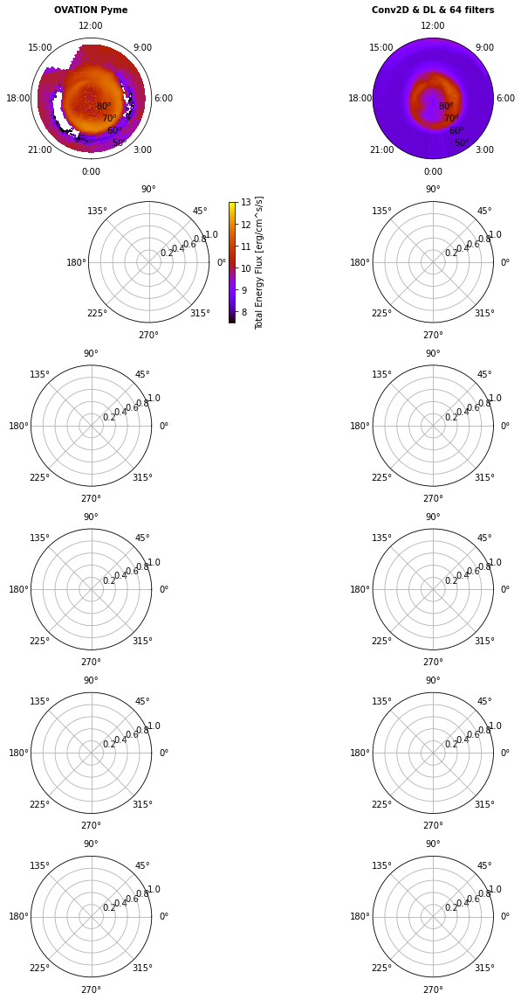

In [32]:
plot_model_multiple_polar([model],['Conv2D & DL & 64 filters'], [scaler_X], [keys], [2], [1],df_val[60*30:(df_val.shape[0]):60*60])


In [33]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
# model.save(filename)
model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})


history = model.fit(training_generator, 
                    validation_data=validation_generator,
                    batch_size=params['batch_size'],epochs=300,#verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=60)], use_multiprocessing=True,
                     workers=6)#

Epoch 1/300
7180/7180 [==============================] - 3365s 469ms/step - loss: 765.5154 - custom_mse: 1.4132 - val_loss: 22.6174 - val_custom_mse: 0.7321
Epoch 2/300
7180/7180 [==============================] - 3322s 463ms/step - loss: 760.8646 - custom_mse: 1.4185 - val_loss: 23.1322 - val_custom_mse: 0.7593
Epoch 3/300
7180/7180 [==============================] - 4017s 559ms/step - loss: 761.5831 - custom_mse: 1.4152 - val_loss: 23.6591 - val_custom_mse: 0.7626
Epoch 4/300
7180/7180 [==============================] - 4550s 634ms/step - loss: 761.9578 - custom_mse: 1.4174 - val_loss: 22.7960 - val_custom_mse: 0.7366
Epoch 5/300
7180/7180 [==============================] - 3298s 459ms/step - loss: 766.4771 - custom_mse: 1.4156 - val_loss: 23.8147 - val_custom_mse: 0.7904
Epoch 6/300
7180/7180 [==============================] - 3298s 459ms/step - loss: 761.1821 - custom_mse: 1.4085 - val_loss: 22.6941 - val_custom_mse: 0.7248
Epoch 7/300
7180/7180 [==============================] - 3

7180/7180 [==============================] - 3301s 460ms/step - loss: 758.3052 - custom_mse: 1.4046 - val_loss: 22.9506 - val_custom_mse: 0.7378
Epoch 9/300
7180/7180 [==============================] - 3296s 459ms/step - loss: 762.4891 - custom_mse: 1.4095 - val_loss: 22.3157 - val_custom_mse: 0.7062
Epoch 10/300
7180/7180 [==============================] - 3297s 459ms/step - loss: 764.6177 - custom_mse: 1.4154 - val_loss: 24.4346 - val_custom_mse: 0.7793
Epoch 11/300
7180/7180 [==============================] - 3296s 459ms/step - loss: 757.4359 - custom_mse: 1.4085 - val_loss: 22.4391 - val_custom_mse: 0.7172
Epoch 12/300
7180/7180 [==============================] - 3294s 459ms/step - loss: 760.5978 - custom_mse: 1.4084 - val_loss: 22.8888 - val_custom_mse: 0.7430
Epoch 13/300
7180/7180 [==============================] - 3294s 459ms/step - loss: 772.5117 - custom_mse: 1.4517 - val_loss: 22.5776 - val_custom_mse: 0.7268
Epoch 14/300
7180/7180 [==============================] - 3293s 45

7180/7180 [==============================] - 3291s 458ms/step - loss: 759.9441 - custom_mse: 1.4109 - val_loss: 22.8161 - val_custom_mse: 0.7392
Epoch 18/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 755.0191 - custom_mse: 1.4028 - val_loss: 22.9201 - val_custom_mse: 0.7513
Epoch 19/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 757.2366 - custom_mse: 1.4111 - val_loss: 23.9061 - val_custom_mse: 0.7666
Epoch 20/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 764.8995 - custom_mse: 1.4148 - val_loss: 22.9553 - val_custom_mse: 0.7403
Epoch 21/300
7180/7180 [==============================] - 3292s 458ms/step - loss: 757.9075 - custom_mse: 1.4103 - val_loss: 23.2527 - val_custom_mse: 0.7400
Epoch 22/300
7180/7180 [==============================] - 3293s 459ms/step - loss: 755.8146 - custom_mse: 1.4068 - val_loss: 22.8999 - val_custom_mse: 0.7473
Epoch 23/300
7180/7180 [==============================] - 3294s 4

7180/7180 [==============================] - 3476s 484ms/step - loss: 757.0356 - custom_mse: 1.4044 - val_loss: 22.9629 - val_custom_mse: 0.7352
Epoch 26/300
7180/7180 [==============================] - 3481s 485ms/step - loss: 761.5358 - custom_mse: 1.4107 - val_loss: 22.8194 - val_custom_mse: 0.7392
Epoch 27/300
7180/7180 [==============================] - 3422s 477ms/step - loss: 755.1823 - custom_mse: 1.4052 - val_loss: 22.7763 - val_custom_mse: 0.7324
Epoch 28/300
7180/7180 [==============================] - 3437s 479ms/step - loss: 753.1122 - custom_mse: 1.4025 - val_loss: 22.4111 - val_custom_mse: 0.7164
Epoch 29/300
7180/7180 [==============================] - 3523s 491ms/step - loss: 757.7612 - custom_mse: 1.4115 - val_loss: 23.0024 - val_custom_mse: 0.7447
Epoch 30/300
7180/7180 [==============================] - 3299s 459ms/step - loss: 767.5982 - custom_mse: 1.4256 - val_loss: 32.9470 - val_custom_mse: 1.0586
Epoch 31/300
7180/7180 [==============================] - 3292s 4

7180/7180 [==============================] - 3293s 459ms/step - loss: 760.3331 - custom_mse: 1.4075 - val_loss: 22.4948 - val_custom_mse: 0.7041
Epoch 34/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 757.0283 - custom_mse: 1.4067 - val_loss: 23.0280 - val_custom_mse: 0.7406
Epoch 35/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 760.3310 - custom_mse: 1.4066 - val_loss: 25.2319 - val_custom_mse: 0.8373
Epoch 36/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 755.6271 - custom_mse: 1.4065 - val_loss: 22.7086 - val_custom_mse: 0.6928
Epoch 37/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 755.9448 - custom_mse: 1.4050 - val_loss: 22.6820 - val_custom_mse: 0.7275
Epoch 38/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 765.4858 - custom_mse: 1.4145 - val_loss: 23.9404 - val_custom_mse: 0.7635
Epoch 39/300
7180/7180 [==============================] - 3288s 4

7180/7180 [==============================] - 3287s 458ms/step - loss: 754.8853 - custom_mse: 1.4070 - val_loss: 23.0836 - val_custom_mse: 0.7459
Epoch 42/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 767.7905 - custom_mse: 1.4194 - val_loss: 23.0158 - val_custom_mse: 0.7359
Epoch 43/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 757.3248 - custom_mse: 1.3971 - val_loss: 25.8768 - val_custom_mse: 0.8573
Epoch 44/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 758.4086 - custom_mse: 1.4026 - val_loss: 22.5771 - val_custom_mse: 0.7307
Epoch 45/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 761.6091 - custom_mse: 1.4107 - val_loss: 24.0471 - val_custom_mse: 0.7777
Epoch 46/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 782.3391 - custom_mse: 1.4416 - val_loss: 23.2348 - val_custom_mse: 0.7390
Epoch 47/300
7180/7180 [==============================] - 3288s 4

Epoch 50/300
7180/7180 [==============================] - 3469s 483ms/step - loss: 760.6914 - custom_mse: 1.4085 - val_loss: 22.7966 - val_custom_mse: 0.7288
Epoch 51/300
7180/7180 [==============================] - 3517s 490ms/step - loss: 758.9312 - custom_mse: 1.4082 - val_loss: 23.2465 - val_custom_mse: 0.7413
Epoch 52/300
7180/7180 [==============================] - 3477s 484ms/step - loss: 762.6570 - custom_mse: 1.4124 - val_loss: 22.7151 - val_custom_mse: 0.7271
Epoch 53/300
7180/7180 [==============================] - 3329s 464ms/step - loss: 757.3126 - custom_mse: 1.4120 - val_loss: 22.9459 - val_custom_mse: 0.7410
Epoch 54/300
7180/7180 [==============================] - 3557s 495ms/step - loss: 757.5079 - custom_mse: 1.4024 - val_loss: 23.3115 - val_custom_mse: 0.7579
Epoch 55/300
7180/7180 [==============================] - 3316s 462ms/step - loss: 756.0854 - custom_mse: 1.4015 - val_loss: 22.6750 - val_custom_mse: 0.7289
Epoch 56/300
7180/7180 [============================

7180/7180 [==============================] - 3289s 458ms/step - loss: 762.8348 - custom_mse: 1.4142 - val_loss: 22.7236 - val_custom_mse: 0.7274
Epoch 59/300
7180/7180 [==============================] - 3292s 459ms/step - loss: 748.8463 - custom_mse: 1.4017 - val_loss: 22.2972 - val_custom_mse: 0.7194
Epoch 60/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 755.5567 - custom_mse: 1.4041 - val_loss: 23.1885 - val_custom_mse: 0.7494
Epoch 61/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 751.4218 - custom_mse: 1.3987 - val_loss: 22.8600 - val_custom_mse: 0.7293
Epoch 62/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 754.8171 - custom_mse: 1.4027 - val_loss: 22.6824 - val_custom_mse: 0.7337
Epoch 63/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 758.0963 - custom_mse: 1.4060 - val_loss: 22.5403 - val_custom_mse: 0.7212
Epoch 64/300
7180/7180 [==============================] - 3288s 4

7180/7180 [==============================] - 3288s 458ms/step - loss: 753.0729 - custom_mse: 1.4051 - val_loss: 23.0141 - val_custom_mse: 0.7363
Epoch 67/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 763.4030 - custom_mse: 1.4145 - val_loss: 23.6957 - val_custom_mse: 0.7777
Epoch 68/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 755.1686 - custom_mse: 1.4019 - val_loss: 24.2185 - val_custom_mse: 0.7931
Epoch 69/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 758.4020 - custom_mse: 1.4065 - val_loss: 23.6348 - val_custom_mse: 0.7662
Epoch 70/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 756.6388 - custom_mse: 1.4027 - val_loss: 22.9002 - val_custom_mse: 0.7282
Epoch 71/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 759.2693 - custom_mse: 1.4040 - val_loss: 23.6294 - val_custom_mse: 0.7654
Epoch 72/300
7180/7180 [==============================] - 3287s 4

7180/7180 [==============================] - 3294s 459ms/step - loss: 758.7534 - custom_mse: 1.4072 - val_loss: 29.8277 - val_custom_mse: 0.9205
Epoch 75/300
7180/7180 [==============================] - 3297s 459ms/step - loss: 762.0828 - custom_mse: 1.4059 - val_loss: 25.0400 - val_custom_mse: 0.7759
Epoch 76/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 760.8186 - custom_mse: 1.4109 - val_loss: 24.3365 - val_custom_mse: 0.7910
Epoch 77/300
7180/7180 [==============================] - 3293s 459ms/step - loss: 764.5769 - custom_mse: 1.4137 - val_loss: 25.9198 - val_custom_mse: 0.8516
Epoch 78/300
7180/7180 [==============================] - 3432s 478ms/step - loss: 757.8917 - custom_mse: 1.4163 - val_loss: 23.5903 - val_custom_mse: 0.7811
Epoch 79/300
7180/7180 [==============================] - 3326s 463ms/step - loss: 768.0753 - custom_mse: 1.4242 - val_loss: 23.3323 - val_custom_mse: 0.7545
Epoch 80/300
7180/7180 [==============================] - 3300s 4

7180/7180 [==============================] - 3402s 474ms/step - loss: 759.7202 - custom_mse: 1.4081 - val_loss: 23.4960 - val_custom_mse: 0.7501
Epoch 83/300
7180/7180 [==============================] - 3353s 467ms/step - loss: 755.5172 - custom_mse: 1.4167 - val_loss: 23.3663 - val_custom_mse: 0.7531
Epoch 84/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 758.1469 - custom_mse: 1.3999 - val_loss: 28.2428 - val_custom_mse: 0.9342
Epoch 85/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 754.0149 - custom_mse: 1.3975 - val_loss: 26.9946 - val_custom_mse: 0.8660
Epoch 86/300
7180/7180 [==============================] - 3292s 458ms/step - loss: 757.7205 - custom_mse: 1.4001 - val_loss: 22.3302 - val_custom_mse: 0.7164
Epoch 87/300
7180/7180 [==============================] - 3292s 458ms/step - loss: 760.9195 - custom_mse: 1.4055 - val_loss: 22.9262 - val_custom_mse: 0.7422
Epoch 88/300
7180/7180 [==============================] - 3292s 4

Epoch 91/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 750.5209 - custom_mse: 1.3982 - val_loss: 23.0646 - val_custom_mse: 0.7475
Epoch 92/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 751.4988 - custom_mse: 1.4103 - val_loss: 22.7931 - val_custom_mse: 0.7288
Epoch 93/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 751.4130 - custom_mse: 1.4020 - val_loss: 22.8312 - val_custom_mse: 0.7441
Epoch 94/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 764.2317 - custom_mse: 1.4131 - val_loss: 24.3893 - val_custom_mse: 0.7652
Epoch 95/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 767.1739 - custom_mse: 1.4243 - val_loss: 22.5595 - val_custom_mse: 0.7208
Epoch 96/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 756.4620 - custom_mse: 1.4023 - val_loss: 25.8087 - val_custom_mse: 0.8505
Epoch 97/300
7180/7180 [============================

7180/7180 [==============================] - 3288s 458ms/step - loss: 756.2809 - custom_mse: 1.3963 - val_loss: 22.8201 - val_custom_mse: 0.7260
Epoch 100/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 756.0040 - custom_mse: 1.4010 - val_loss: 21.9007 - val_custom_mse: 0.6989
Epoch 101/300
7180/7180 [==============================] - 3292s 458ms/step - loss: 755.6566 - custom_mse: 1.4028 - val_loss: 22.2420 - val_custom_mse: 0.7063
Epoch 102/300
7180/7180 [==============================] - 3296s 459ms/step - loss: 762.5103 - custom_mse: 1.4081 - val_loss: 22.9967 - val_custom_mse: 0.7447
Epoch 103/300
7180/7180 [==============================] - 3295s 459ms/step - loss: 768.2217 - custom_mse: 1.4166 - val_loss: 22.1978 - val_custom_mse: 0.6992
Epoch 104/300
7180/7180 [==============================] - 3294s 459ms/step - loss: 753.7266 - custom_mse: 1.3994 - val_loss: 22.4416 - val_custom_mse: 0.7210
Epoch 105/300
7180/7180 [==============================] - 3

7180/7180 [==============================] - 3291s 458ms/step - loss: 761.1943 - custom_mse: 1.4096 - val_loss: 23.0150 - val_custom_mse: 0.7393
Epoch 108/300
7180/7180 [==============================] - 3292s 459ms/step - loss: 752.4951 - custom_mse: 1.3996 - val_loss: 23.3008 - val_custom_mse: 0.7419
Epoch 109/300
7180/7180 [==============================] - 3292s 458ms/step - loss: 753.3496 - custom_mse: 1.4034 - val_loss: 23.2051 - val_custom_mse: 0.7531
Epoch 110/300
7180/7180 [==============================] - 3292s 459ms/step - loss: 751.2361 - custom_mse: 1.3982 - val_loss: 23.8529 - val_custom_mse: 0.7623
Epoch 111/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 755.3524 - custom_mse: 1.4023 - val_loss: 23.0946 - val_custom_mse: 0.7442
Epoch 112/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 754.4690 - custom_mse: 1.3992 - val_loss: 22.3912 - val_custom_mse: 0.7132
Epoch 113/300
7180/7180 [==============================] - 3

7180/7180 [==============================] - 3287s 458ms/step - loss: 760.0874 - custom_mse: 1.4073 - val_loss: 24.5083 - val_custom_mse: 0.7930
Epoch 116/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 751.1329 - custom_mse: 1.3985 - val_loss: 22.4973 - val_custom_mse: 0.7170
Epoch 117/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 758.6335 - custom_mse: 1.4105 - val_loss: 23.6682 - val_custom_mse: 0.7541
Epoch 118/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 758.8672 - custom_mse: 1.4057 - val_loss: 22.5652 - val_custom_mse: 0.6995
Epoch 119/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 758.1571 - custom_mse: 1.4050 - val_loss: 23.0693 - val_custom_mse: 0.7451
Epoch 120/300
7180/7180 [==============================] - 3286s 458ms/step - loss: 751.8661 - custom_mse: 1.3987 - val_loss: 23.4465 - val_custom_mse: 0.7478
Epoch 121/300
7180/7180 [==============================] - 3

7180/7180 [==============================] - 3287s 458ms/step - loss: 755.7382 - custom_mse: 1.4040 - val_loss: 22.3294 - val_custom_mse: 0.7114
Epoch 124/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 760.0915 - custom_mse: 1.4185 - val_loss: 22.8350 - val_custom_mse: 0.7310
Epoch 125/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 753.3147 - custom_mse: 1.3981 - val_loss: 24.8545 - val_custom_mse: 0.7575
Epoch 126/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 774.5353 - custom_mse: 1.4376 - val_loss: 22.6685 - val_custom_mse: 0.7193
Epoch 127/300
7180/7180 [==============================] - 3292s 458ms/step - loss: 751.6955 - custom_mse: 1.3965 - val_loss: 23.3501 - val_custom_mse: 0.7494
Epoch 128/300
7180/7180 [==============================] - 3292s 459ms/step - loss: 760.7634 - custom_mse: 1.4100 - val_loss: 22.9231 - val_custom_mse: 0.7528
Epoch 129/300
7180/7180 [==============================] - 3

Epoch 132/300
7180/7180 [==============================] - 3295s 459ms/step - loss: 752.6428 - custom_mse: 1.3983 - val_loss: 22.3503 - val_custom_mse: 0.7093
Epoch 133/300
7180/7180 [==============================] - 3293s 459ms/step - loss: 757.1772 - custom_mse: 1.4067 - val_loss: 22.5901 - val_custom_mse: 0.7247
Epoch 134/300
7180/7180 [==============================] - 3292s 459ms/step - loss: 755.5764 - custom_mse: 1.4000 - val_loss: 23.9418 - val_custom_mse: 0.7700
Epoch 135/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 755.7343 - custom_mse: 1.4005 - val_loss: 23.3341 - val_custom_mse: 0.7517
Epoch 136/300
7180/7180 [==============================] - 3292s 459ms/step - loss: 751.6082 - custom_mse: 1.3962 - val_loss: 23.8028 - val_custom_mse: 0.7628
Epoch 137/300
7180/7180 [==============================] - 3291s 458ms/step - loss: 752.2079 - custom_mse: 1.3944 - val_loss: 23.9816 - val_custom_mse: 0.7867
Epoch 138/300
7180/7180 [=====================

7180/7180 [==============================] - 3290s 458ms/step - loss: 752.9280 - custom_mse: 1.3973 - val_loss: 22.9746 - val_custom_mse: 0.7398
Epoch 141/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 752.5298 - custom_mse: 1.3983 - val_loss: 23.3101 - val_custom_mse: 0.7596
Epoch 142/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 753.7282 - custom_mse: 1.4017 - val_loss: 24.3672 - val_custom_mse: 0.7995
Epoch 143/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 751.1616 - custom_mse: 1.3956 - val_loss: 23.1627 - val_custom_mse: 0.7483
Epoch 144/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 752.8312 - custom_mse: 1.3984 - val_loss: 24.1829 - val_custom_mse: 0.7804
Epoch 145/300
7180/7180 [==============================] - 3289s 458ms/step - loss: 755.6866 - custom_mse: 1.4010 - val_loss: 22.7957 - val_custom_mse: 0.7278
Epoch 146/300
7180/7180 [==============================] - 3

7180/7180 [==============================] - 3287s 458ms/step - loss: 757.2842 - custom_mse: 1.4074 - val_loss: 22.9341 - val_custom_mse: 0.7402
Epoch 149/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 754.7981 - custom_mse: 1.4063 - val_loss: 22.6181 - val_custom_mse: 0.7273
Epoch 150/300
7180/7180 [==============================] - 3287s 458ms/step - loss: 750.5612 - custom_mse: 1.4002 - val_loss: 22.5246 - val_custom_mse: 0.7289
Epoch 151/300
7180/7180 [==============================] - 3288s 458ms/step - loss: 766.5202 - custom_mse: 1.4167 - val_loss: 23.4078 - val_custom_mse: 0.7518
Epoch 152/300
7180/7180 [==============================] - 3290s 458ms/step - loss: 754.1561 - custom_mse: 1.3985 - val_loss: 22.7383 - val_custom_mse: 0.7291
Epoch 153/300
7180/7180 [==============================] - 3401s 474ms/step - loss: 754.5336 - custom_mse: 1.4002 - val_loss: 24.9602 - val_custom_mse: 0.7960
Epoch 154/300
1281/7180 [====>.........................] - E

Process Keras_worker_ForkPoolWorker-6435:
Process Keras_worker_ForkPoolWorker-6438:
Process Keras_worker_ForkPoolWorker-6437:
Process Keras_worker_ForkPoolWorker-6433:
Process Keras_worker_ForkPoolWorker-6434:
Process Keras_worker_ForkPoolWorker-6436:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 25

KeyboardInterrupt: 

Process Keras_worker_ForkPoolWorker-6440:
Process Keras_worker_ForkPoolWorker-6443:
Process Keras_worker_ForkPoolWorker-6442:
Process Keras_worker_ForkPoolWorker-6444:
Process Keras_worker_ForkPoolWorker-6439:
Process Keras_worker_ForkPoolWorker-6441:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 25

In [35]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
model.save(filename)
#model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})


history = model.fit(training_generator, 
                    validation_data=validation_generator,
                    batch_size=params['batch_size'],epochs=1,#verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=60)], use_multiprocessing=True,
                     workers=6)#

INFO:tensorflow:Assets written to: mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f/assets
7180/7180 [==============================] - 3391s 472ms/step - loss: 754.3948 - custom_mse: 1.4038 - val_loss: 22.6414 - val_custom_mse: 0.7220


INFO:tensorflow:Assets written to: mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f/assets


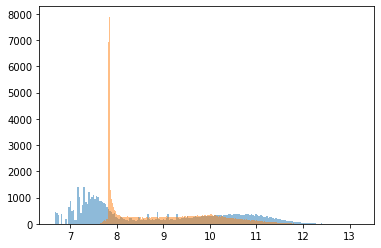

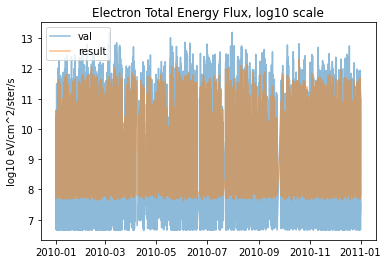

<Figure size 432x288 with 0 Axes>

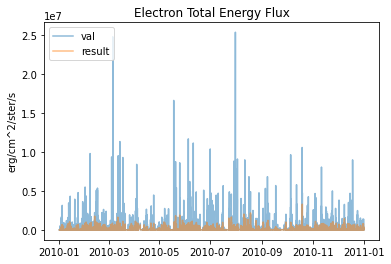

<Figure size 432x288 with 0 Axes>

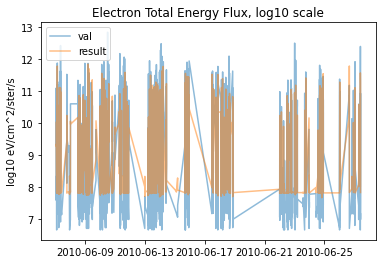

<Figure size 432x288 with 0 Axes>

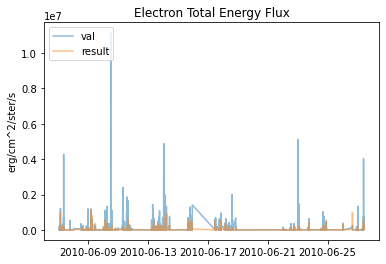

<Figure size 432x288 with 0 Axes>

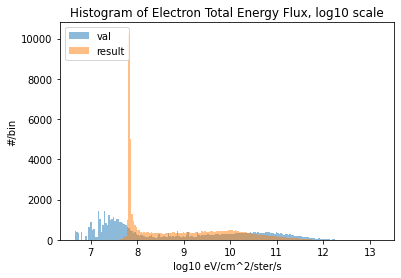

<Figure size 432x288 with 0 Axes>

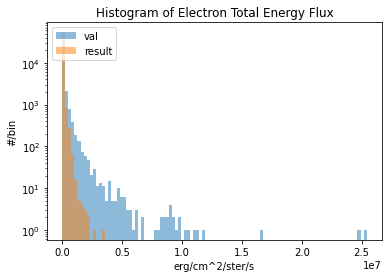

<Figure size 432x288 with 0 Axes>

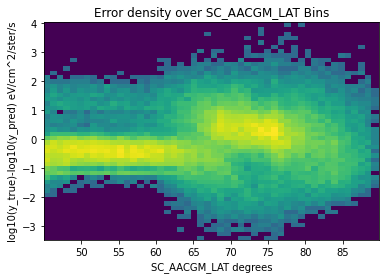

<Figure size 432x288 with 0 Axes>

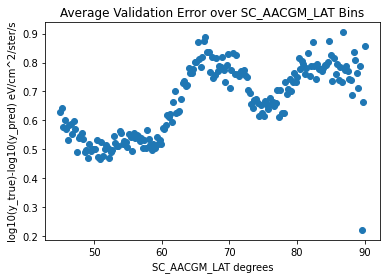

<Figure size 432x288 with 0 Axes>

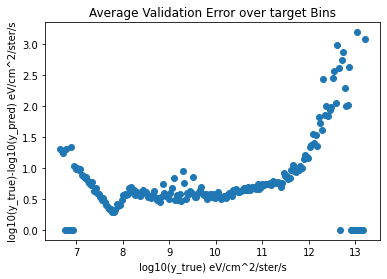

<Figure size 432x288 with 0 Axes>

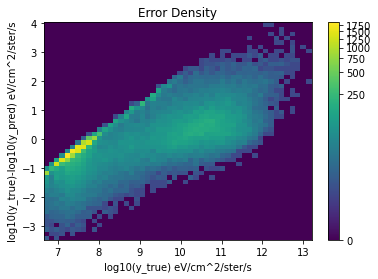

<Figure size 432x288 with 0 Axes>

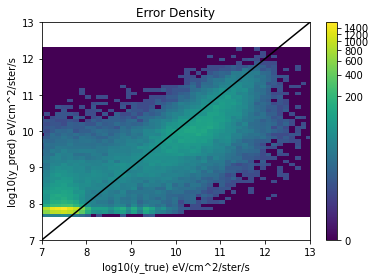

In [36]:
filename='mse_new_pipeline_145_2D_128x128_periodic_dropout_tailloss_pipline1_distmaybe64f'
model.save(filename)
#model = tensorflow.keras.models.load_model(filename, custom_objects={'custom_loss': custom_loss, 'custom_mse': custom_mse})


result_val = for_CSV_val(scaler_X, model, features, df_val, XX_test)
np.average((y_val_log-(np.array(result_val)))**2)

plt.figure()
plt.hist(y_val_log,  alpha=0.5, bins=200)
plt.hist( result_val, alpha=0.5, bins=200)
plt.show()

dpi=200
df_results = pd.DataFrame(data=result_val, index = df_val.index)

plot_model(df_results, df_val)